# Analysis of Xenium ( considering non-expanded cells)

In [165]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import xb.plotting as xp
import xb.formatting as xf

In [166]:
saving_path=r'../../data/processed_adata'
adata=sc.read(saving_path+'/adata_msbrain_3rep_withclusters_only_nuclei_starting_Class.h5ad')

In [167]:
adata.obs['Class_old']=adata.obs['Class']

In [168]:
annotation=pd.read_csv(r"../../data/annotation_dictionaries/number_to_annotation_updated_cluster_3rep_only_nuclei_class.csv",sep=';')
cluster02_class=dict(zip(annotation['cluster_0_2'],annotation['Class']))
adata.obs['Class']=adata.obs['leiden_0_2'].astype(int).map(cluster02_class)
adata.obs['class_number']=adata.obs['leiden_0_2'].astype(str)+'_'+adata.obs['Class']

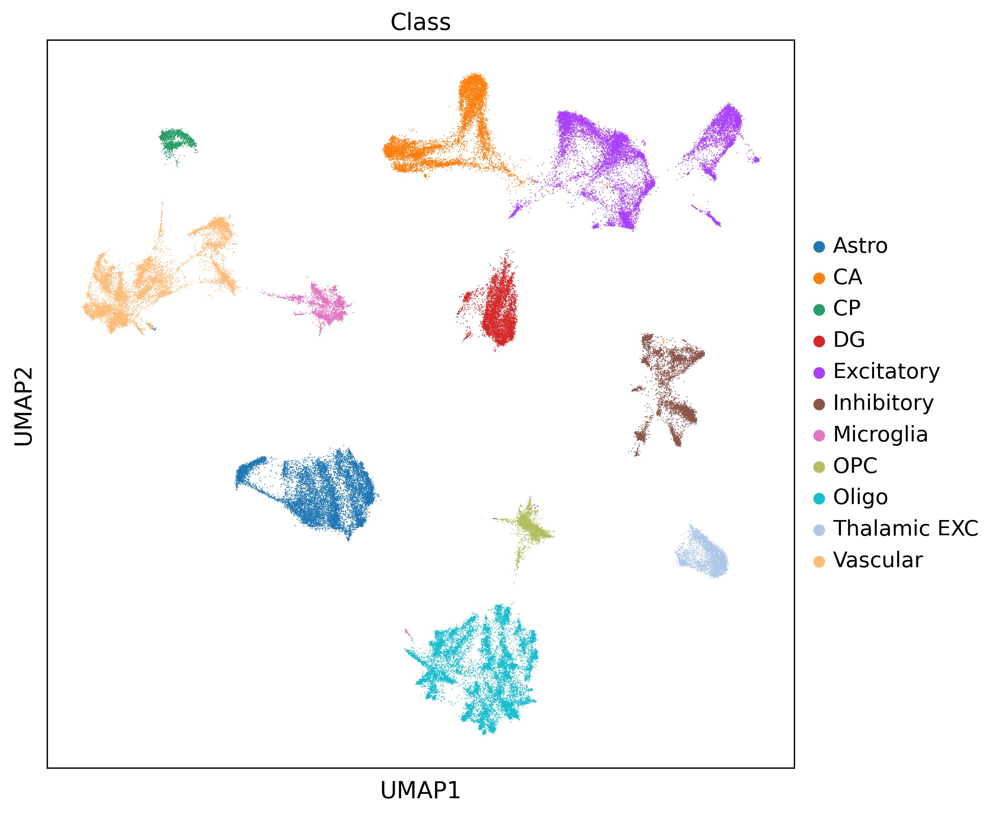

In [169]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(8,8))
sc.pl.umap(adata,color=['Class'],save='classes_plot.pdf')

# Start working with Astro

In [170]:
adata.layers['raw']=adata.raw.X

In [236]:
adataastro=adata[adata.obs['Class']=='Astro']

In [237]:
sc.pp.scale(adataastro,max_value=100)

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [239]:
sc.pp.neighbors(adataastro, n_neighbors=15, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.8,key_added='leiden_0_8_astro')
sc.tl.leiden(adataastro,resolution=0.2,key_added='leiden_0_2_astro')
sc.tl.umap(adataastro,min_dist=0.1)

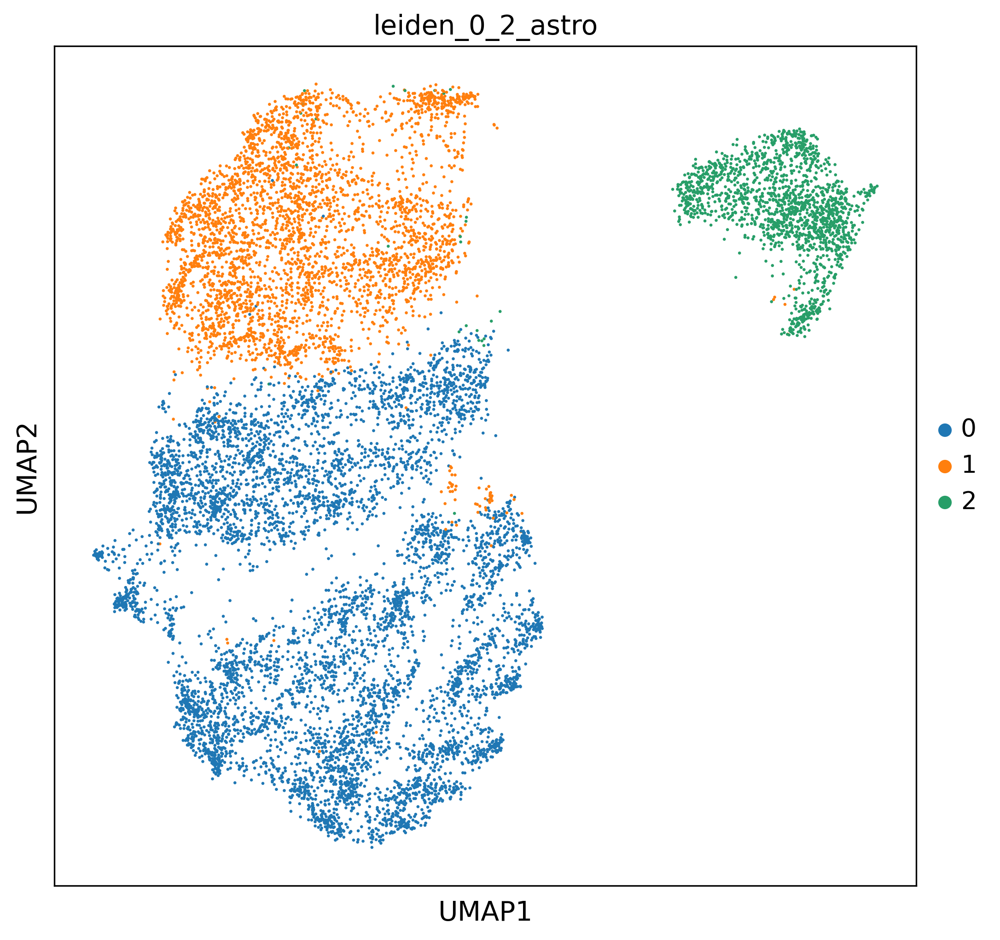

In [252]:
sc.pl.umap(adataastro,color=['leiden_0_2_astro'],vmax=2)#,save='astro_leiden_1_0.pdf')

In [260]:
annot={'0':'Astro1','2':'Ependymal','1':'Astro2'}

In [261]:
adataastro.obs['astro_annot']=adataastro.obs['leiden_0_2_astro'].astype(str).map(annot)

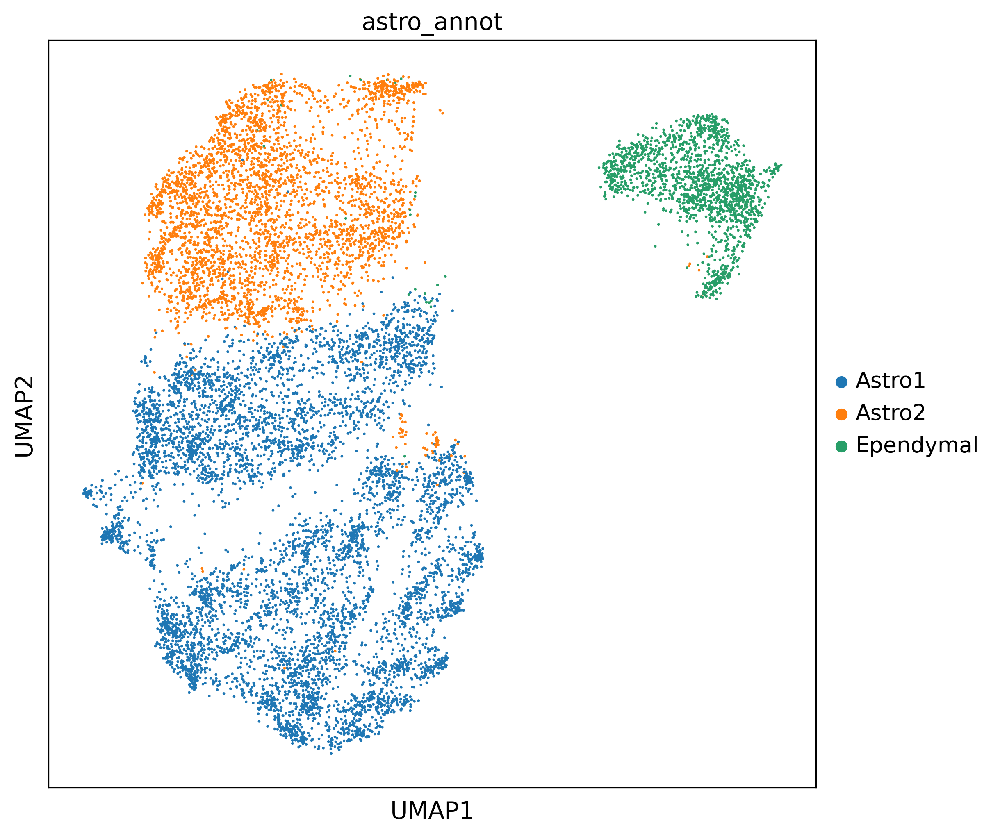

In [262]:
sc.pl.umap(adataastro,color=['astro_annot'],vmax=2)#,save='astro_leiden_1_0.pdf')

In [263]:
adataastro.obs['astro_annot']=adataastro.obs['astro_annot'].astype(str)

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:352: RuntimeWarning: invalid value encountered in log1p
  np.log1p(X, out=X)


{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

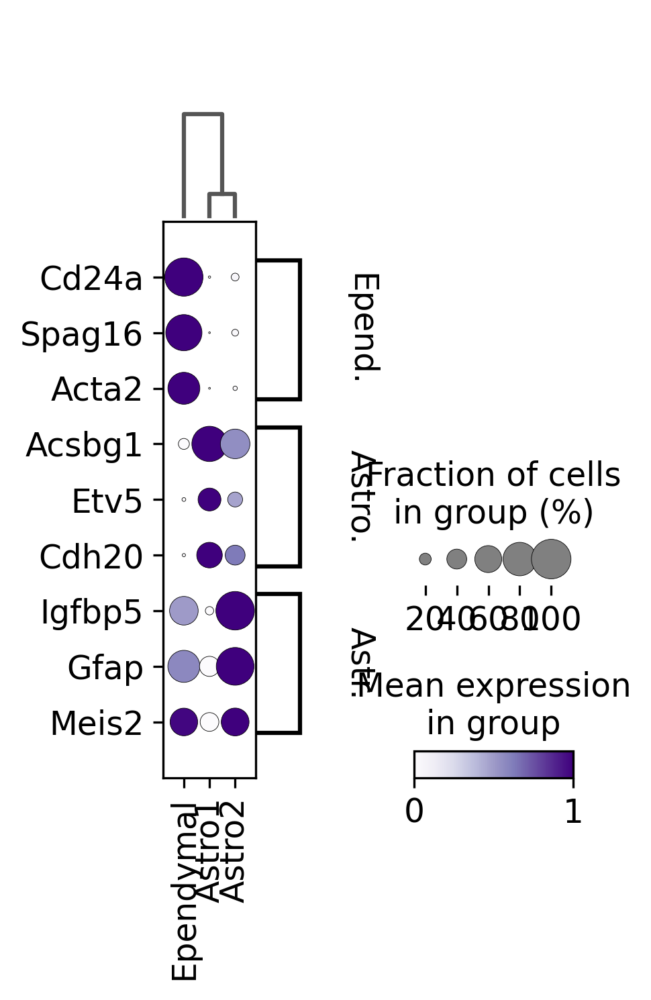

In [266]:
sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby='astro_annot', method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.tl.dendrogram(adataastro2,groupby='astro_annot')
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=3,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

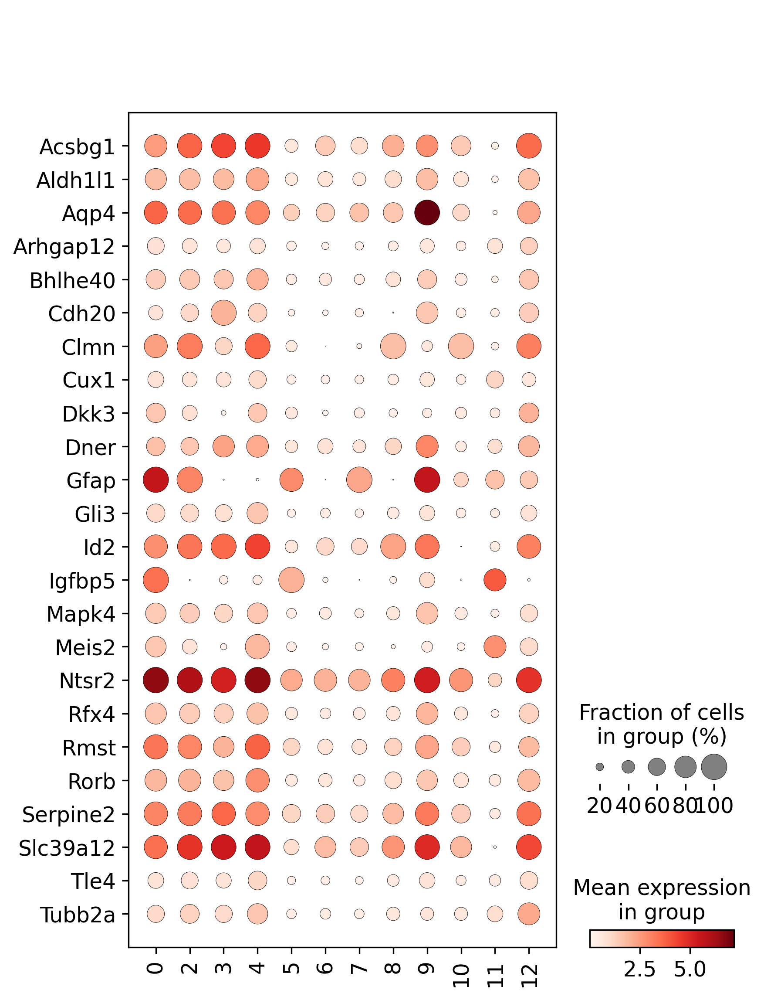

In [159]:
sc.pl.dotplot(adataastro2,gn,groupby='leiden_1_0_astro',swap_axes=True)

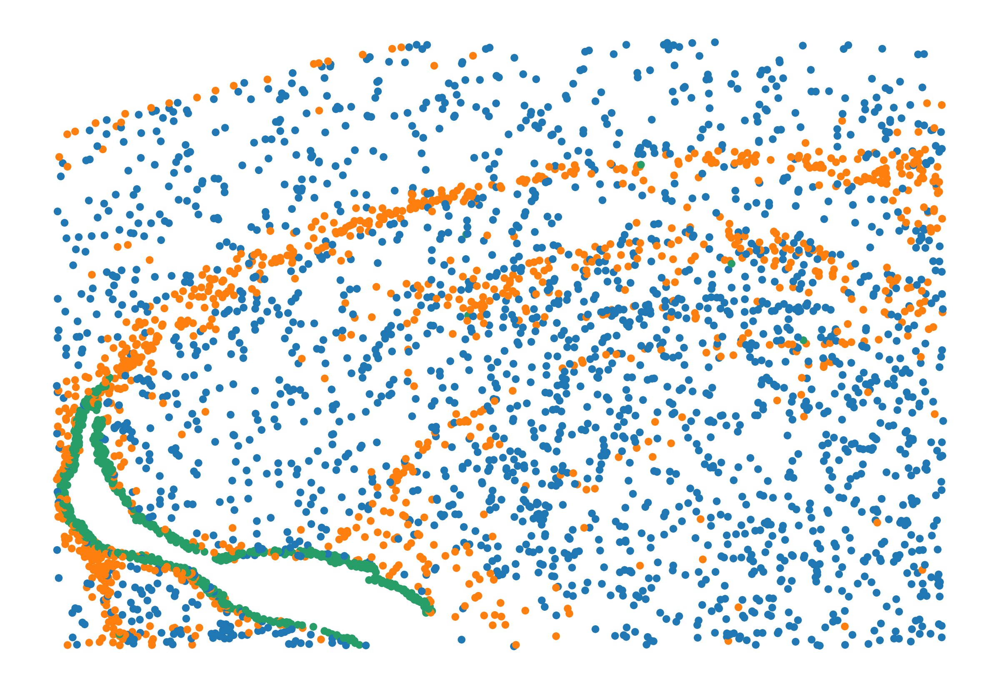

In [268]:
asub=adataastro[adataastro.obs['replicate']=='1']
xp.map_of_clusters(asub,key='astro_annot',size=20)

In [163]:
exp=pd.read_csv(r"../../data/scRNAseq/mean_expression_Yao_150kcells_384_ref_cluster_label.csv",index_col=0)

In [196]:
expastro=pd.DataFrame(adataastro.raw.X,columns=adataastro.var.index)
expastro['celltype']=list(adataastro.obs['leiden_1_0_astro'])
expastro=expastro.groupby('celltype').mean()
exp=exp.loc[:,exp.columns.isin(expastro.columns)]
expastro=expastro.loc[:,expastro.columns.isin(exp.columns)]
exp=exp.fillna(0)
expastro=expastro.fillna(0)
exp=exp.loc[:,expastro.columns]
tbl=pd.DataFrame(index=expastro.index,columns=exp.index)
for ind in expastro.index:
    for col in exp.index:
        tbl.loc[ind,col]=np.corrcoef(expastro.loc[ind,:],exp.loc[col,:])[0,1]


In [270]:
adataastro.write(saving_path+'/adata_msbrain_3rep_astro.h5ad')

# OPC

In [271]:
adataastro=adata[adata.obs['Class']=='OPC']

In [282]:
sc.pp.neighbors(adataastro, n_neighbors=15, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.8,key_added='leiden_0_8_astro')
sc.tl.leiden(adataastro,resolution=0.6,key_added='leiden_0_6_astro')
sc.tl.umap(adataastro,min_dist=0.1)

In [286]:
adataastro

AnnData object with n_obs × n_vars = 2750 × 284
    obs: 'ind', 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'graph_clusters', 'kmeans2_clusters', 'kmeans3_clusters', 'kmeans4_clusters', 'kmeans5_clusters', 'kmeans6_clusters', 'kmeans7_clusters', 'kmeans8_clusters', 'kmeans9_clusters', 'kmeans10_clusters', 'replicate', 'n_counts', 'leiden_2_2', 'leiden_1_8', 'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6', 'cell_code', 'expanded_class', 'expanded_initial_annotation', 'Class', 'initial_annotation', 'celltype_annotation', 'X', 'Y', 'leiden_0_4', 'leiden_0_2', 'class_number', 'leiden_2_2_astro', 'leiden_1_8_astro', 'leiden_1_4_astro', 'leiden_1_0_astro', 'leiden_0_8_astro', 'leiden_0_2_astro', 'leiden_0_4_astro', 'leiden_0_6_astro'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Class_colors', 'expanded_class_colors', 'expanded_initial_anno

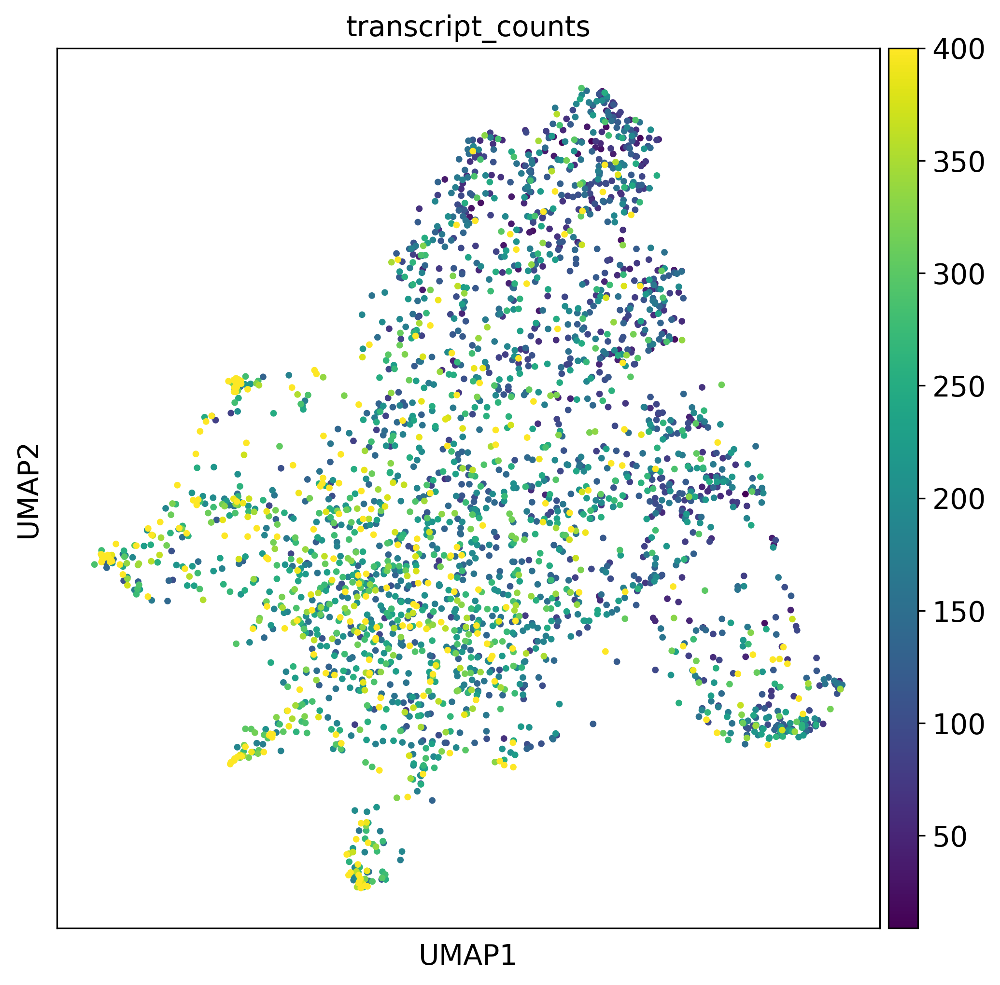

In [291]:
sc.pl.umap(adataastro,color=['transcript_counts'],vmax=400)

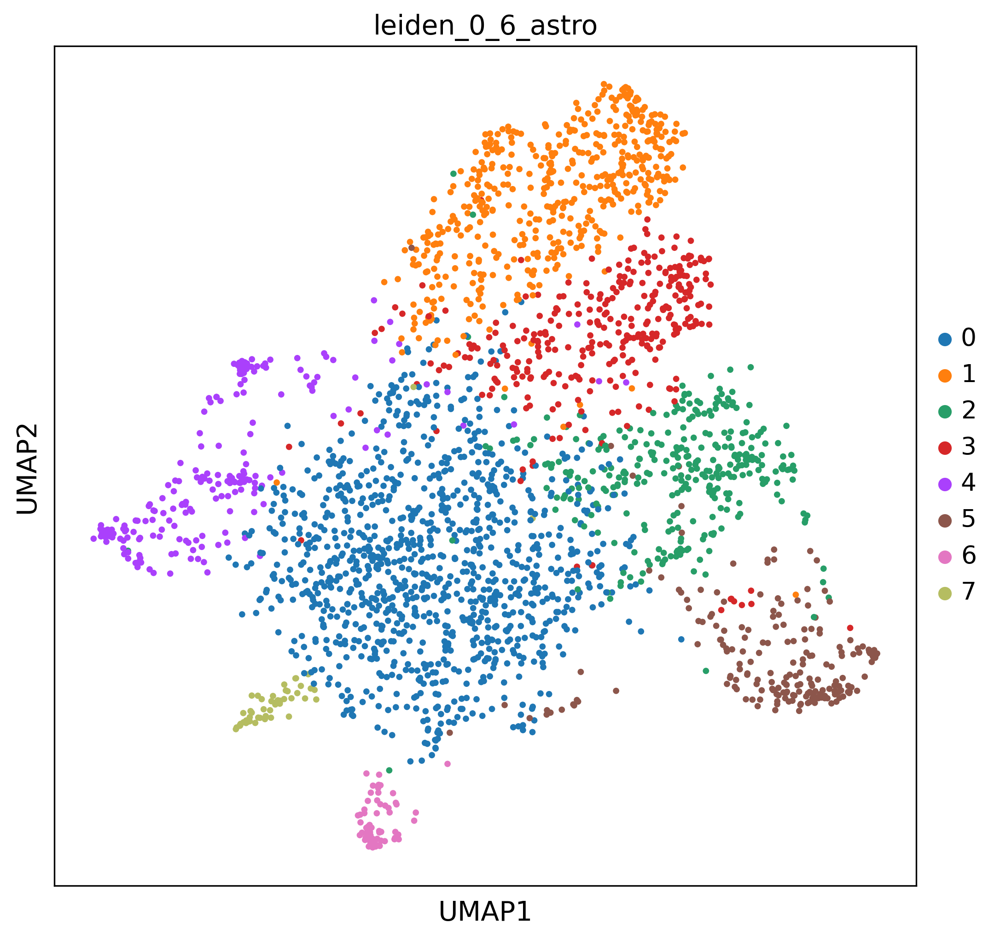

In [284]:
sc.pl.umap(adataastro,color=['leiden_0_6_astro'],vmax=2,save='opc_leiden_0_6.pdf')

{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

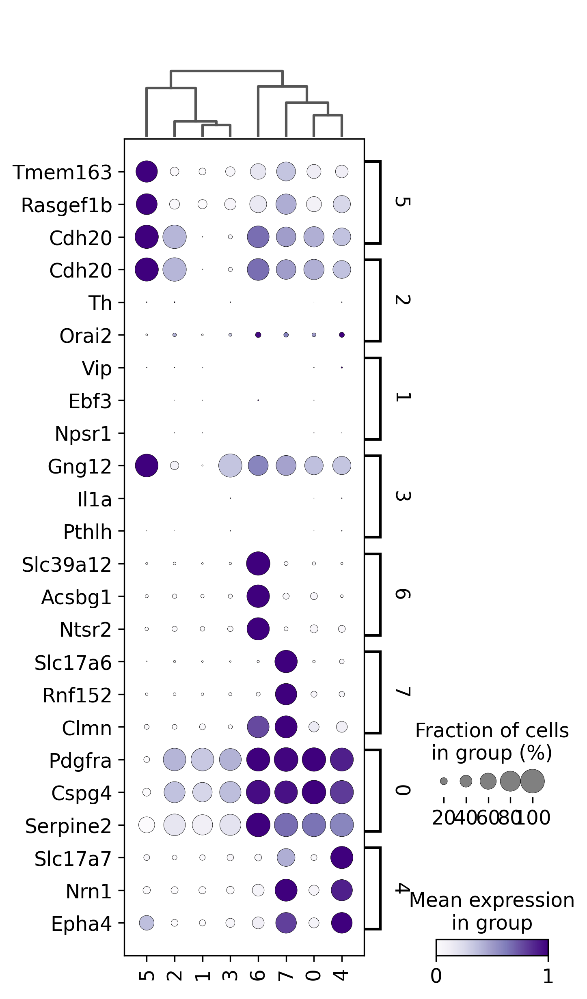

In [285]:
key='leiden_0_6_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=3,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

In [292]:
expastro=pd.DataFrame(adataastro.raw.X,columns=adataastro.var.index)
expastro['celltype']=list(adataastro.obs['leiden_0_6_astro'])
expastro=expastro.groupby('celltype').mean()
exp=exp.loc[:,exp.columns.isin(expastro.columns)]
expastro=expastro.loc[:,expastro.columns.isin(exp.columns)]
exp=exp.fillna(0)
expastro=expastro.fillna(0)
exp=exp.loc[:,expastro.columns]
tbl=pd.DataFrame(index=expastro.index,columns=exp.index)
for ind in expastro.index:
    for col in exp.index:
        tbl.loc[ind,col]=np.corrcoef(expastro.loc[ind,:],exp.loc[col,:])[0,1]


In [295]:
tbl.astype(float).idxmax(axis=1)

celltype
0      360_OPC
1      360_OPC
2      360_OPC
3      359_OPC
4      360_OPC
5    362_Oligo
6      359_OPC
7      359_OPC
dtype: object

In [296]:
annot={'0':'OPC','2':'OPC','1':'OPC','3':'OPC','4':'OPC','5':'COP','6':'OPC','7':'OPC'}

In [298]:
adataastro.obs['annot']=adataastro.obs['leiden_0_6_astro'].astype(str).map(annot)

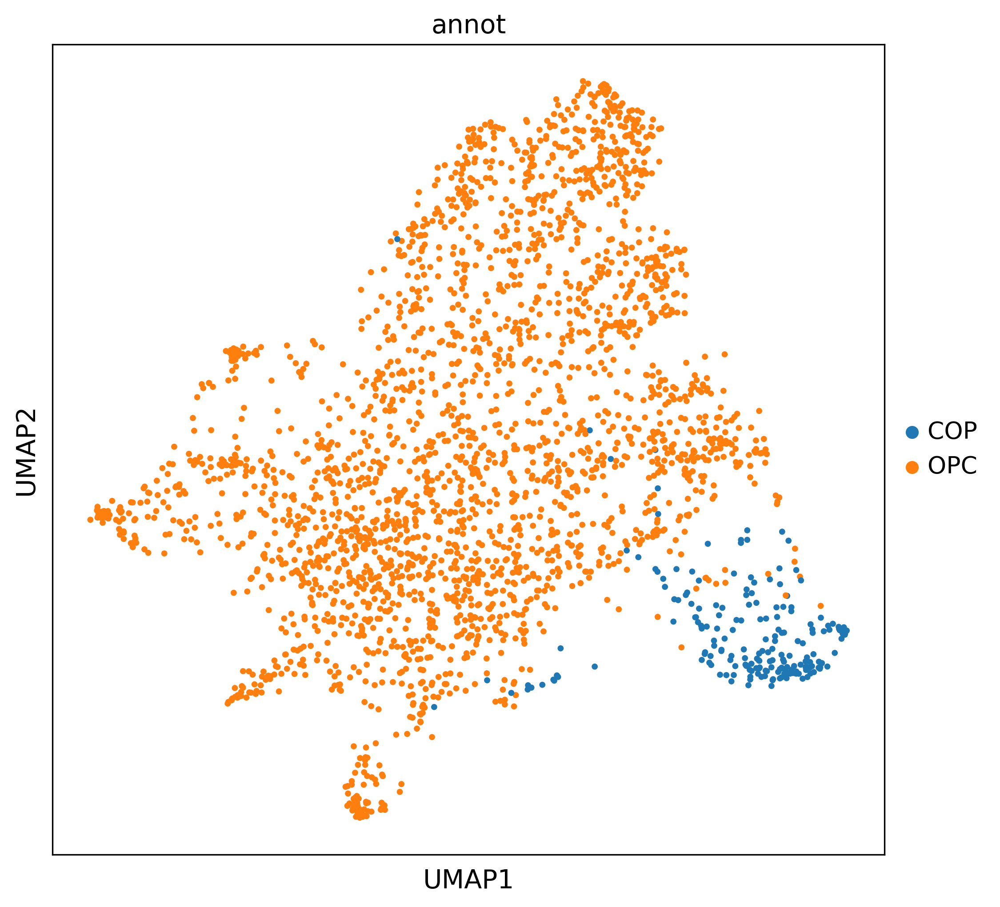

In [300]:
sc.pl.umap(adataastro,color=['annot'],vmax=2)#,save='astro_leiden_1_0.pdf')

In [301]:
adataastro.write(saving_path+'/adata_msbrain_3rep_OPC.h5ad')

# MICROGLIA

In [302]:
adata.obs['Class'].unique()

['Oligo', 'Astro', 'Microglia', 'Excitatory', 'Inhibitory', ..., 'OPC', 'CA', 'CP', 'Thalamic EXC', 'DG']
Length: 11
Categories (11, object): ['Astro', 'CA', 'CP', 'DG', ..., 'OPC', 'Oligo', 'Thalamic EXC', 'Vascular']

In [320]:
adataastro=adata[adata.obs['Class']=='Microglia']

In [318]:
#sc.pp.scale(adataastro)

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [321]:
sc.pp.neighbors(adataastro, n_neighbors=15, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.4,key_added='leiden_0_4_astro')
sc.tl.leiden(adataastro,resolution=0.2,key_added='leiden_0_2_astro')
sc.tl.umap(adataastro,min_dist=0.1)

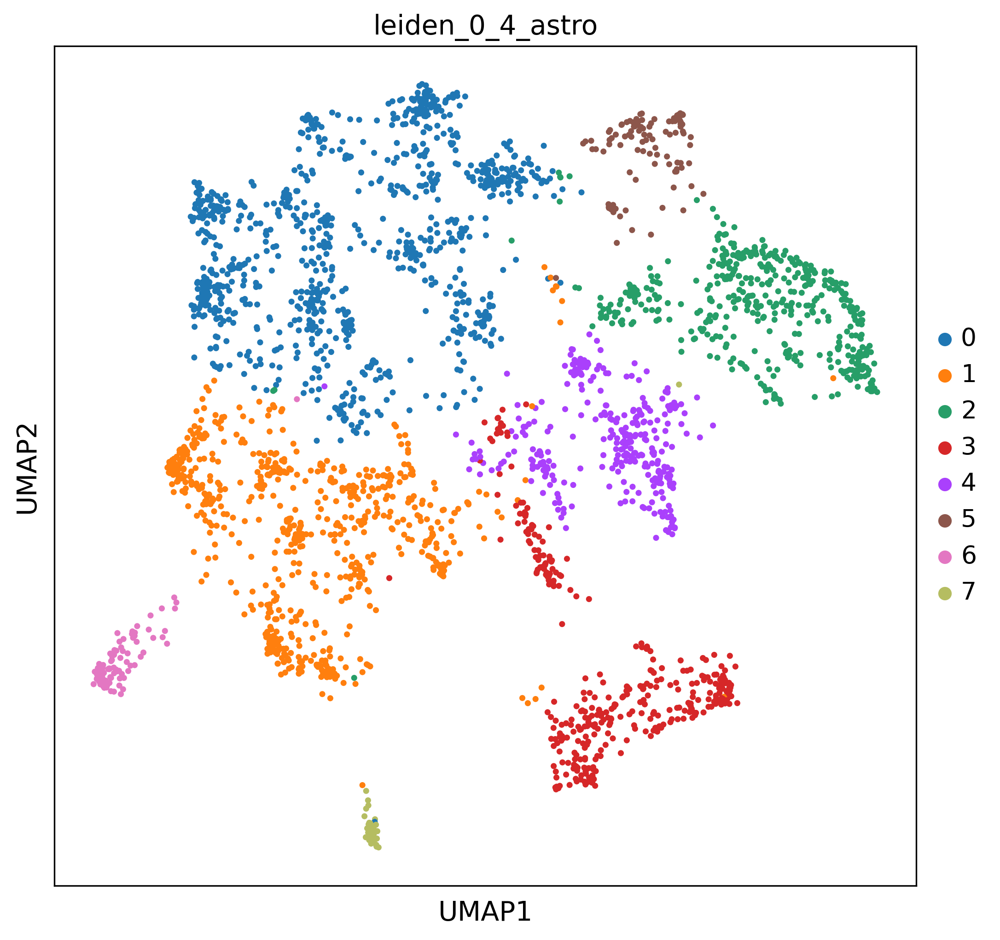

In [324]:
sc.pl.umap(adataastro,color=['leiden_0_4_astro'],vmax=2,save='microglia_leiden_0_6.pdf')

{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

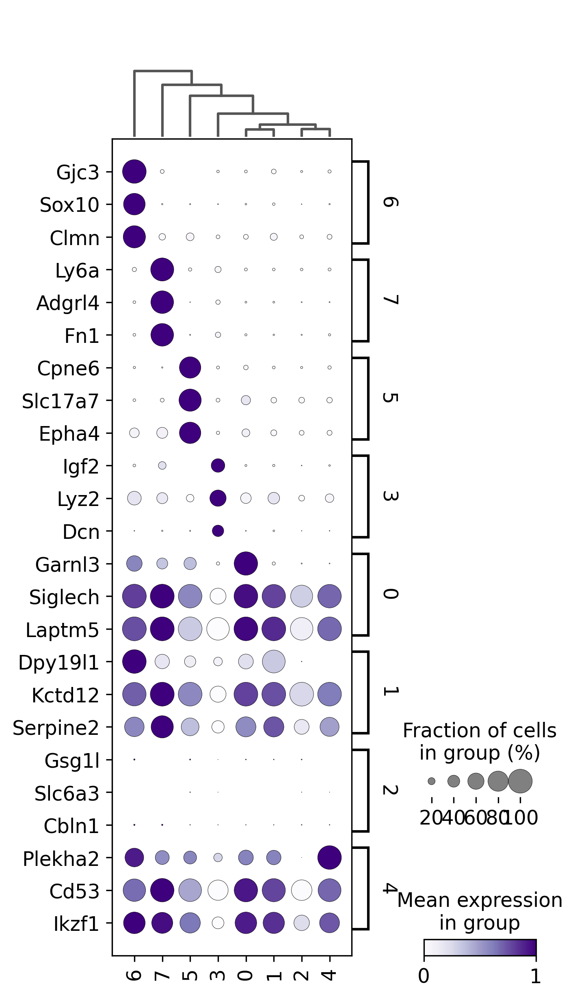

In [325]:
key='leiden_0_4_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=3,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

/mnt/d/Xenium_benchmarking-main/Xenium_benchmarking-main/xb/plotting.py:22: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key]=adata.obs[key].astype(int)


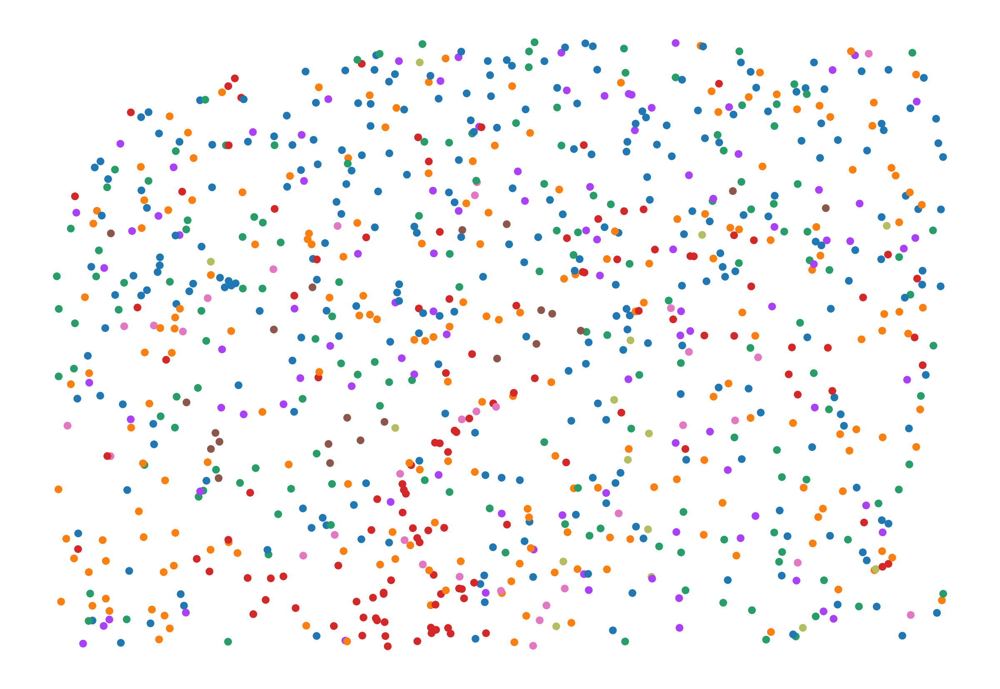

In [326]:
asub=adataastro[adataastro.obs['replicate']=='1']
xp.map_of_clusters(asub,key='leiden_0_4_astro',size=20)

In [327]:
annot={'0':'Microglia','2':'Microglia','1':'Microglia','3':'Perivascular_macrophages','4':'Microglia','5':'Microglia','6':'Microglia','7':'Microglia'}

In [328]:
adataastro.obs['annot']=adataastro.obs['leiden_0_4_astro'].astype(str).map(annot)

In [330]:
adataastro.write(saving_path+'/adata_msbrain_3rep_microglia.h5ad')

# Vascular

In [216]:
adata.obs['Class'].unique()
adataastro=adata[adata.obs['Class']=='Vascular']
sc.pp.neighbors(adataastro, n_neighbors=15, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.4,key_added='leiden_0_4_astro')
sc.tl.leiden(adataastro,resolution=0.2,key_added='leiden_0_2_astro')
sc.tl.umap(adataastro,min_dist=0.1)

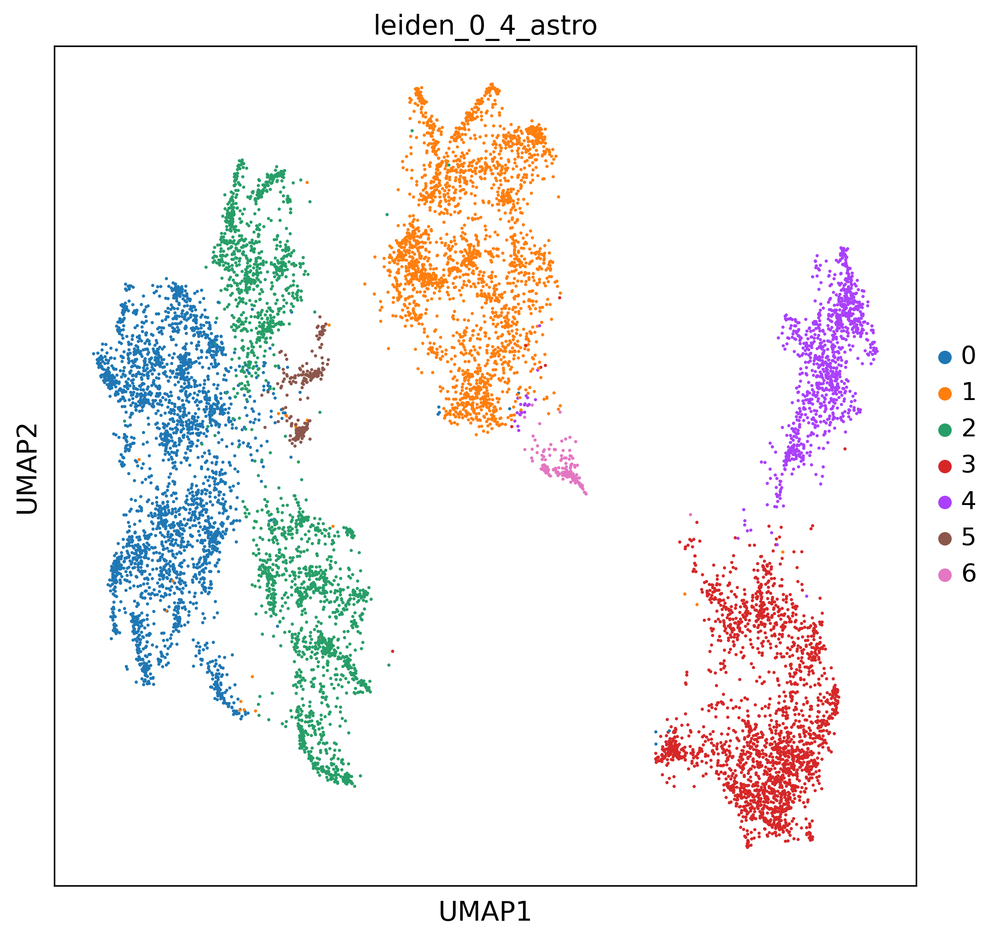

In [217]:
sc.pl.umap(adataastro,color=['leiden_0_4_astro'],vmax=2,save='vascular_leiden_0_4.pdf')

{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

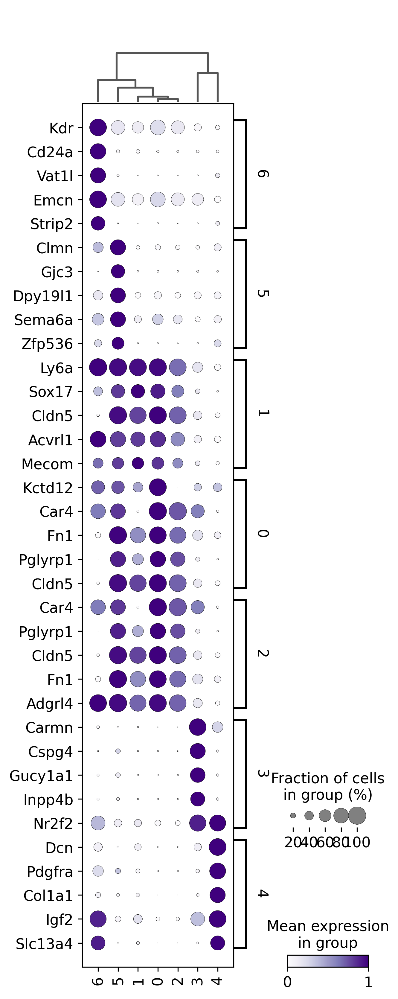

In [218]:
key='leiden_0_4_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=5,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

In [219]:
expastro=pd.DataFrame(adataastro.raw.X,columns=adataastro.var.index)
expastro['celltype']=list(adataastro.obs['leiden_0_4_astro'])
expastro=expastro.groupby('celltype').mean()
exp=exp.loc[:,exp.columns.isin(expastro.columns)]
expastro=expastro.loc[:,expastro.columns.isin(exp.columns)]
exp=exp.fillna(0)
expastro=expastro.fillna(0)
exp=exp.loc[:,expastro.columns]
tbl=pd.DataFrame(index=expastro.index,columns=exp.index)
for ind in expastro.index:
    for col in exp.index:
        tbl.loc[ind,col]=np.corrcoef(expastro.loc[ind,:],exp.loc[col,:])[0,1]
tbl.astype(float).idxmax(axis=1)

celltype
0        Endo Tek
1        Endo Tek
2        Endo Tek
3    Peri Atp13a5
4        VLMC Dcn
5        Endo Tek
6        Endo Tek
dtype: object

In [220]:
tbl.astype(float).idxmax(axis=1)

celltype
0        Endo Tek
1        Endo Tek
2        Endo Tek
3    Peri Atp13a5
4        VLMC Dcn
5        Endo Tek
6        Endo Tek
dtype: object

In [221]:
annot={'0':'Car4+ EC','2':'Car4+ EC','1':'Car4- EC','3':'Pericytes','4':'VLMC','5':'Car4+ EC','6':'Car4- EC'}

In [222]:
adataastro.obs['annot']=adataastro.obs['leiden_0_4_astro'].astype(str).map(annot)

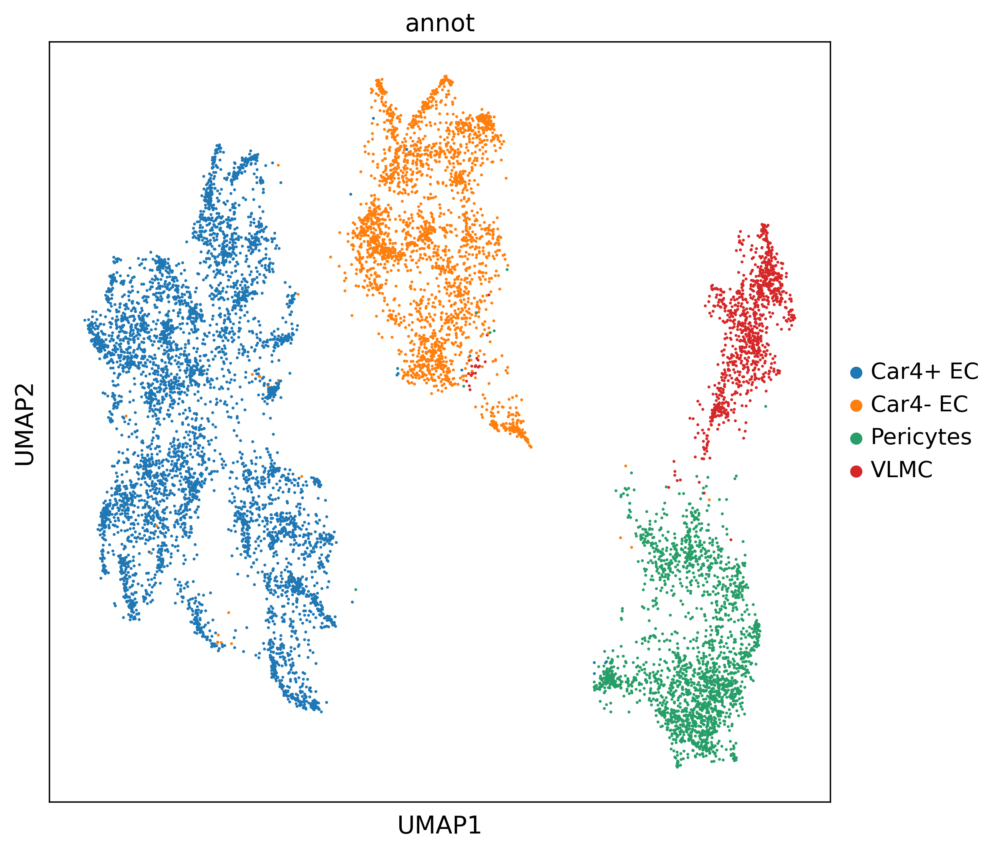

In [223]:
sc.pl.umap(adataastro,color=['annot'],vmax=2)

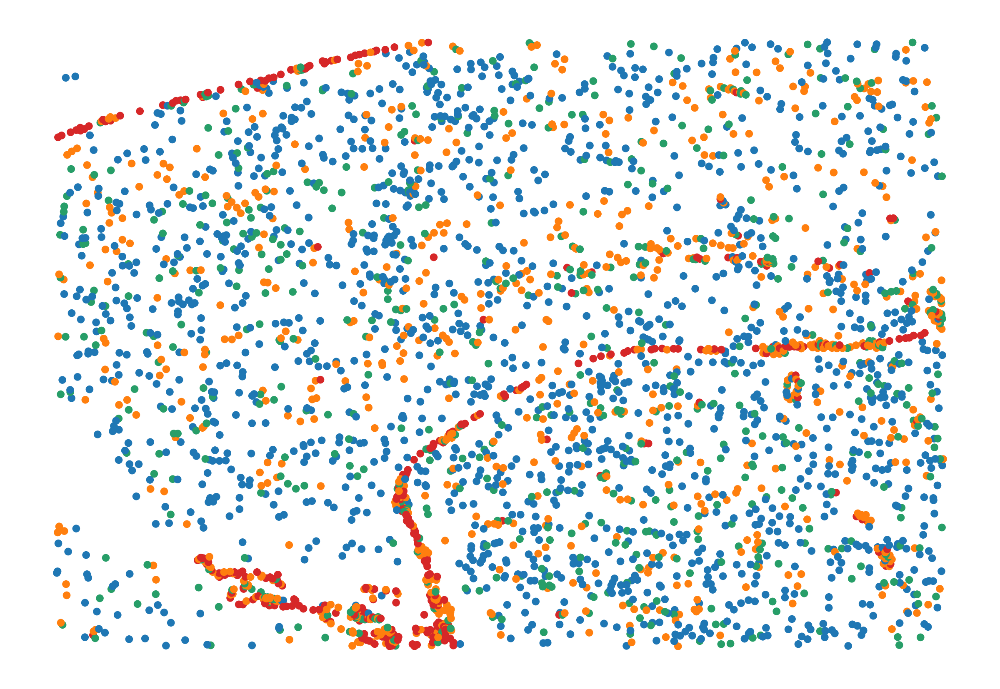

In [224]:
asub=adataastro[adataastro.obs['replicate']=='1']
xp.map_of_clusters(asub,key='annot',size=20)

In [225]:
adataastro.write(saving_path+'/adata_msbrain_3rep_vascular.h5ad')

# CP (homogeneus)

In [379]:
adataastro=adata[adata.obs['Class']=='CP']

In [380]:
sc.pp.neighbors(adataastro, n_neighbors=15, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.4,key_added='leiden_0_4_astro')
sc.tl.leiden(adataastro,resolution=0.2,key_added='leiden_0_2_astro')
sc.tl.umap(adataastro,min_dist=0.1)

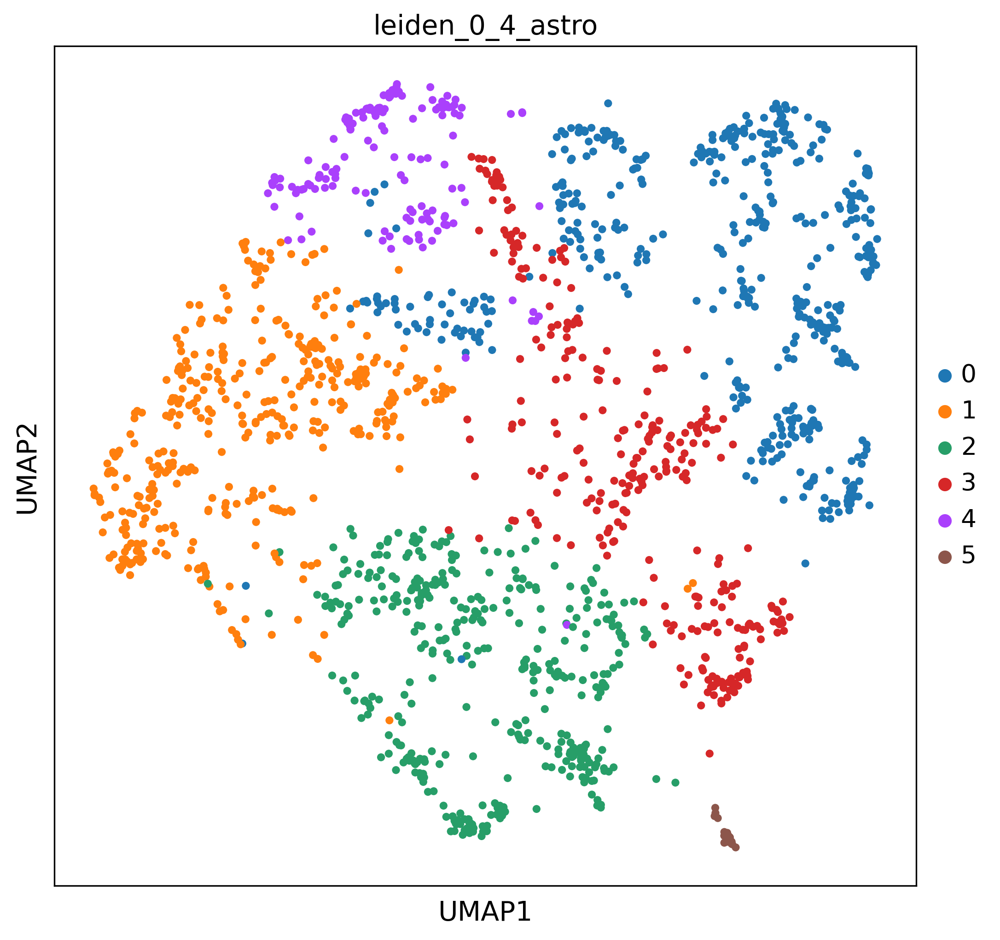

In [381]:
sc.pl.umap(adataastro,color=['leiden_0_4_astro'],vmax=2)#,save='vascular_leiden_0_4.pdf')

{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

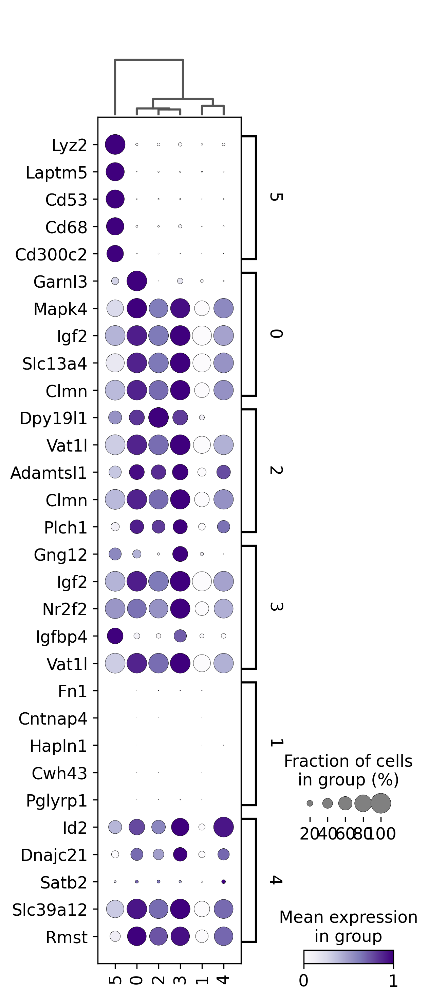

In [382]:
key='leiden_0_4_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=5,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

# CA (HIPPOCAMPUS)

In [412]:
adata.obs['Class'].unique()
adataastro=adata[adata.obs['Class']=='CA']
sc.pp.scale(adataastro)
sc.pp.neighbors(adataastro, n_neighbors=10, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.4,key_added='leiden_0_4_astro')
sc.tl.leiden(adataastro,resolution=0.1,key_added='leiden_0_1_astro')
sc.tl.umap(adataastro,min_dist=0.1)

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


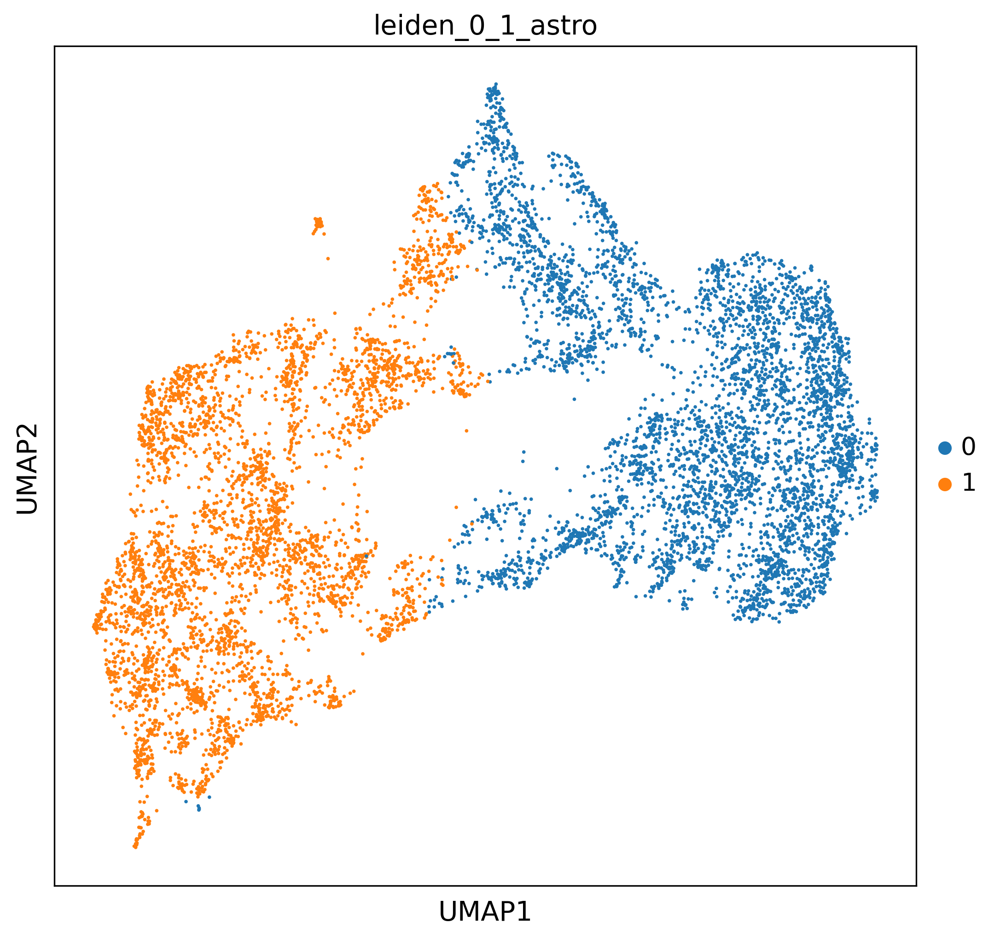

In [413]:
sc.pl.umap(adataastro,color='leiden_0_1_astro',save='CA_leiden_01.pdf')

/mnt/d/Xenium_benchmarking-main/Xenium_benchmarking-main/xb/plotting.py:22: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key]=adata.obs[key].astype(int)


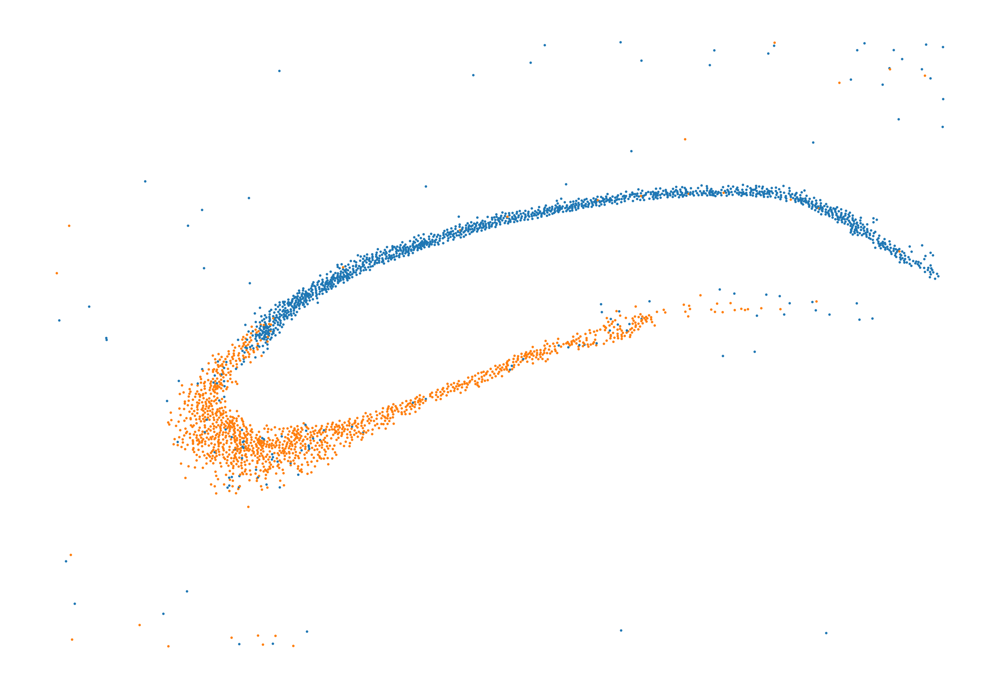

In [415]:
asub=adataastro[adataastro.obs['replicate']=='1']
xp.map_of_clusters(asub,key='leiden_0_1_astro',size=2)

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:352: RuntimeWarning: invalid value encountered in log1p
  np.log1p(X, out=X)


{'mainplot_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

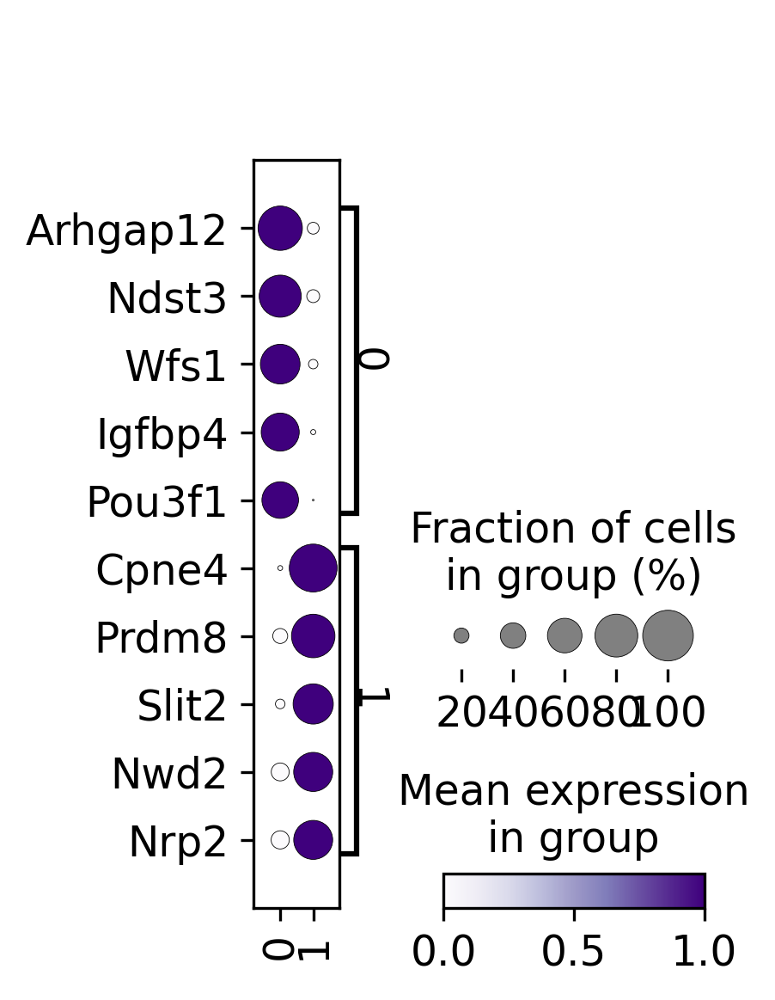

In [416]:
key='leiden_0_1_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=5,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

In [417]:
annot={'0':'CA1','1':'CA2_3'}

In [418]:
adataastro.obs['annot']=adataastro.obs['leiden_0_1_astro'].astype(str).map(annot)

In [420]:
adataastro.write(saving_path+'/adata_msbrain_3rep_CA.h5ad')

# Dentate gyrus

In [422]:
adata.obs['Class'].unique()
adataastro=adata[adata.obs['Class']=='DG']
sc.pp.scale(adataastro)
sc.pp.neighbors(adataastro, n_neighbors=10, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.4,key_added='leiden_0_4_astro')
sc.tl.leiden(adataastro,resolution=0.1,key_added='leiden_0_1_astro')
sc.tl.umap(adataastro,min_dist=0.1)

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


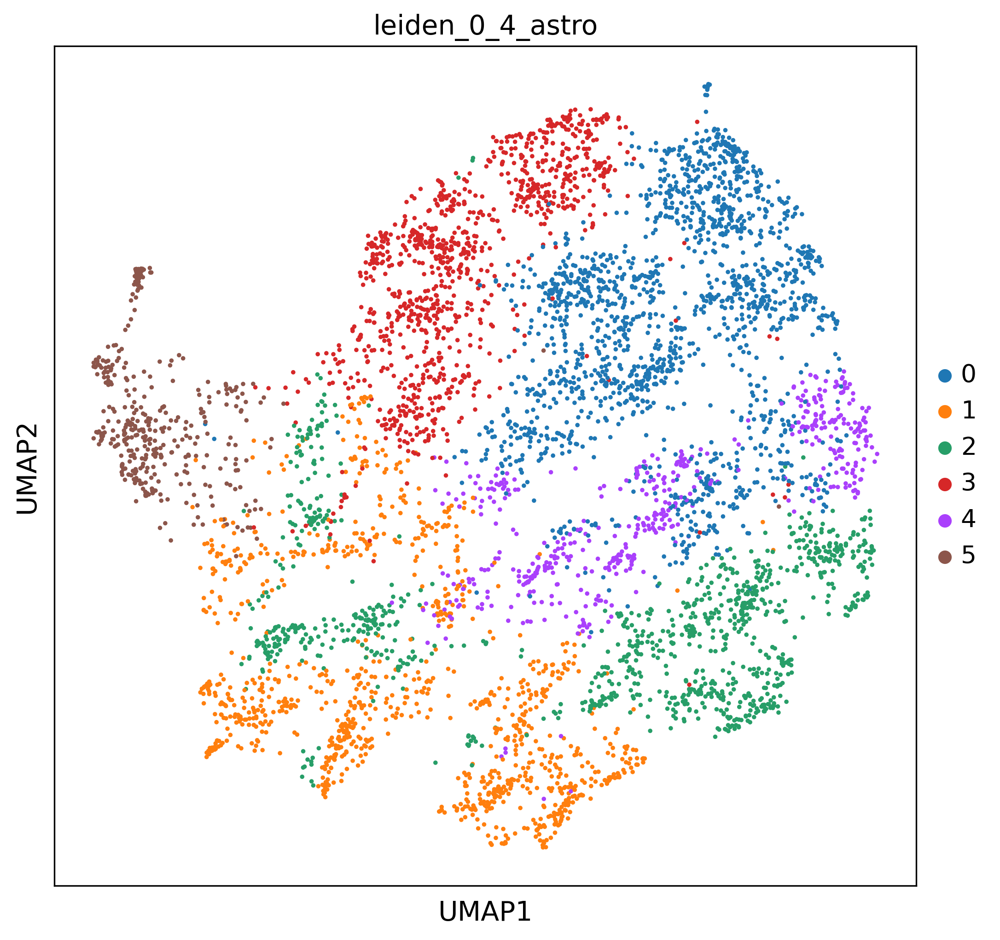

In [425]:
sc.pl.umap(adataastro,color='leiden_0_4_astro',save='DG_leiden_04.pdf')

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:352: RuntimeWarning: invalid value encountered in log1p
  np.log1p(X, out=X)


{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

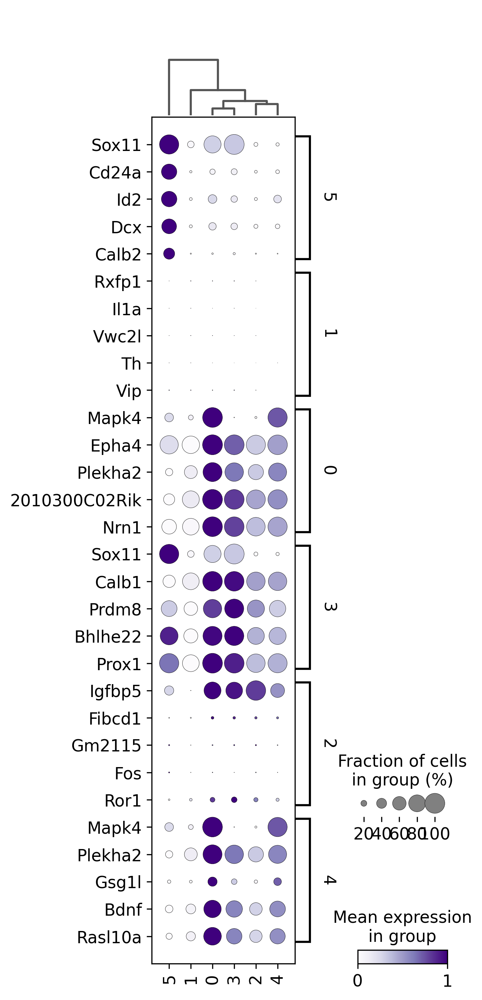

In [424]:
key='leiden_0_4_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=5,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

/mnt/d/Xenium_benchmarking-main/Xenium_benchmarking-main/xb/plotting.py:22: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key]=adata.obs[key].astype(int)


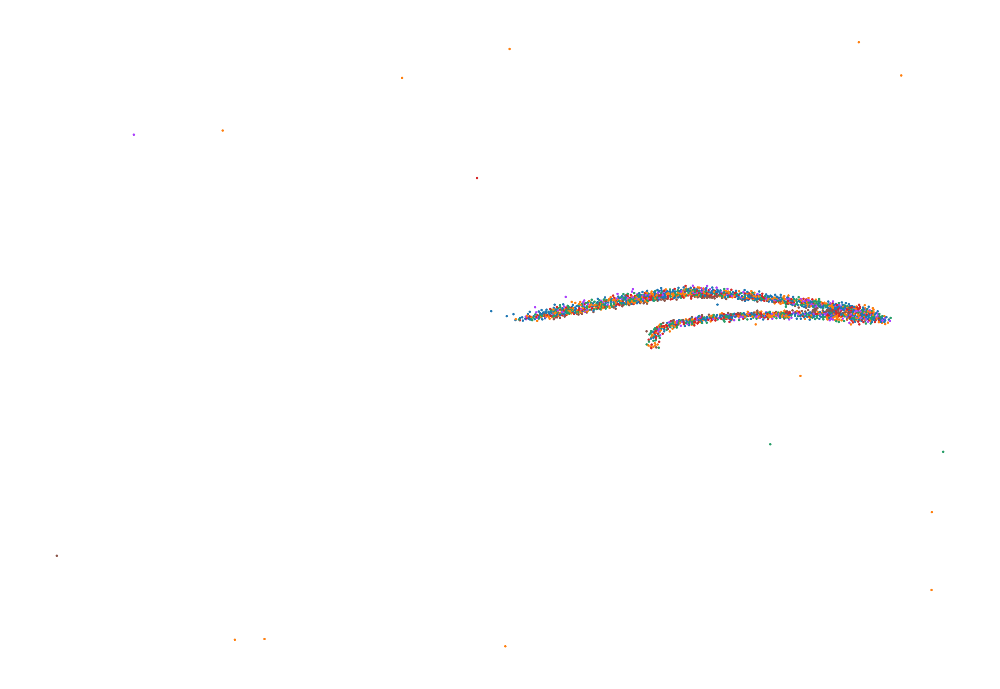

In [426]:
asub=adataastro[adataastro.obs['replicate']=='1']
xp.map_of_clusters(asub,key='leiden_0_4_astro',size=2)

In [427]:
expastro=pd.DataFrame(adataastro.raw.X,columns=adataastro.var.index)
expastro['celltype']=list(adataastro.obs['leiden_0_4_astro'])
expastro=expastro.groupby('celltype').mean()
exp=exp.loc[:,exp.columns.isin(expastro.columns)]
expastro=expastro.loc[:,expastro.columns.isin(exp.columns)]
exp=exp.fillna(0)
expastro=expastro.fillna(0)
exp=exp.loc[:,expastro.columns]
tbl=pd.DataFrame(index=expastro.index,columns=exp.index)
for ind in expastro.index:
    for col in exp.index:
        tbl.loc[ind,col]=np.corrcoef(expastro.loc[ind,:],exp.loc[col,:])[0,1]
tbl.astype(float).idxmax(axis=1)

celltype
0    125_DG_1
1    125_DG_1
2    125_DG_1
3    125_DG_1
4    125_DG_1
5    125_DG_1
dtype: object

In [428]:
annot={'0':'DG','1':'DG','2':'DG','3':'DG','4':'DG','5':'Granule neuroblasts (DG)'}

In [429]:
adataastro.obs['annot']=adataastro.obs['leiden_0_4_astro'].astype(str).map(annot)

In [430]:
adataastro.write(saving_path+'/adata_msbrain_3rep_DG.h5ad')

# THALAMIC EXC

In [445]:
adata.obs['Class'].unique()
adataastro=adata[adata.obs['Class']=='Thalamic EXC']
#sc.pp.scale(adataastro)
sc.pp.neighbors(adataastro, n_neighbors=15, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.4,key_added='leiden_0_4_astro')
sc.tl.leiden(adataastro,resolution=0.1,key_added='leiden_0_1_astro')
sc.tl.umap(adataastro,min_dist=0.1)

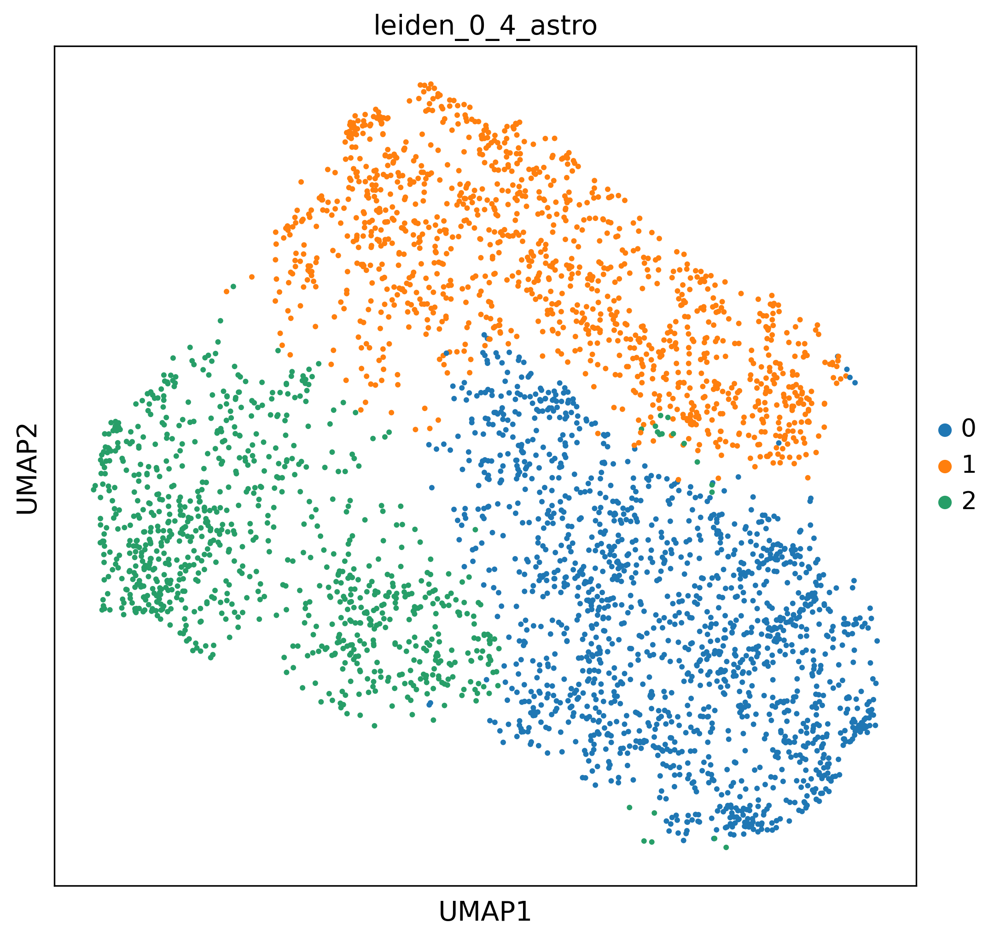

In [446]:
sc.pl.umap(adataastro,color='leiden_0_4_astro',save='THAEXC_leiden_04.pdf')

{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

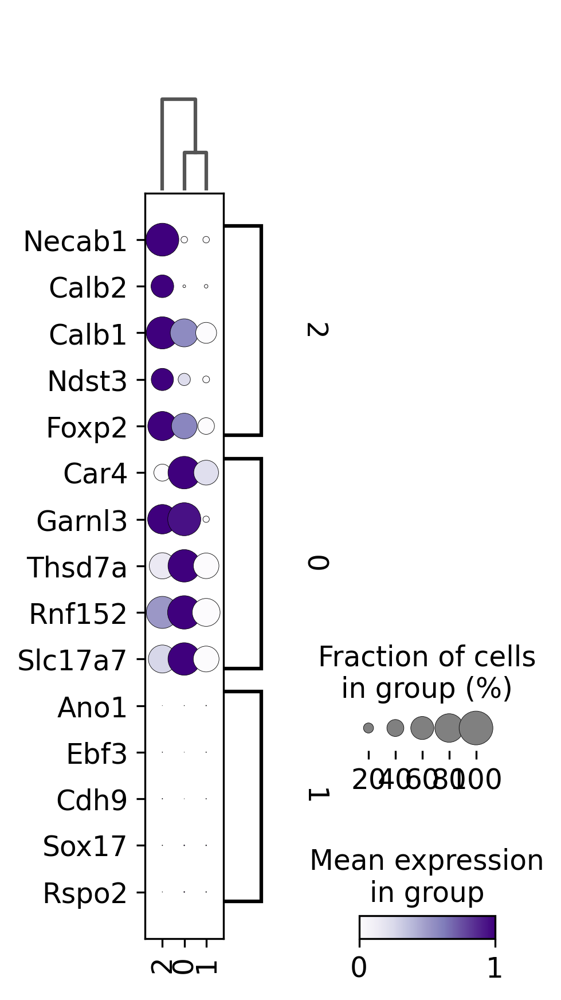

In [447]:
key='leiden_0_4_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=5,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

/mnt/d/Xenium_benchmarking-main/Xenium_benchmarking-main/xb/plotting.py:22: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key]=adata.obs[key].astype(int)


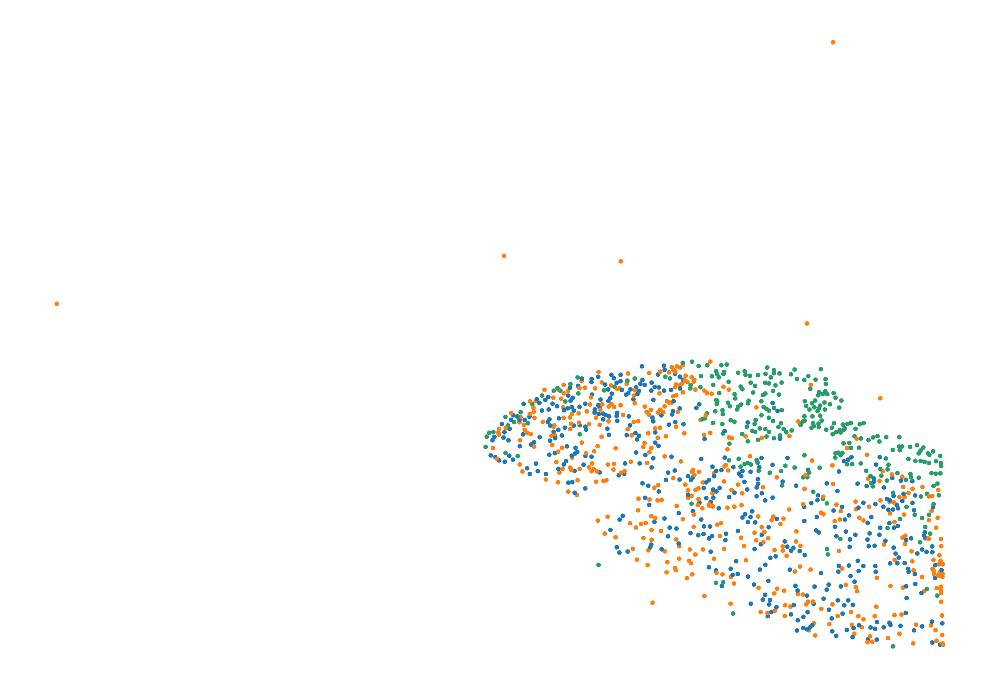

In [448]:
asub=adataastro[adataastro.obs['replicate']=='1']
xp.map_of_clusters(asub,key='leiden_0_4_astro',size=7)

In [449]:
annot={'2':'Thalamic EXC','0':'Hippoth EXC','1':'Hippoth EXC'}

In [450]:
adataastro.obs['annot']=adataastro.obs['leiden_0_4_astro'].astype(str).map(annot)

In [451]:
adataastro.write(saving_path+'/adata_msbrain_3rep_THALEXC.h5ad')

# Inhibitory

In [171]:
adata.obs['Class'].unique()
adataastro=adata[adata.obs['Class']=='Inhibitory']
#sc.pp.scale(adataastro)
sc.pp.neighbors(adataastro, n_neighbors=15, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro')
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro')
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro')
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro')
sc.tl.leiden(adataastro,resolution=0.4,key_added='leiden_0_4_astro')
sc.tl.leiden(adataastro,resolution=0.1,key_added='leiden_0_1_astro')
sc.tl.leiden(adataastro,resolution=0.8,key_added='leiden_0_8_astro')
sc.tl.umap(adataastro,min_dist=0.1)

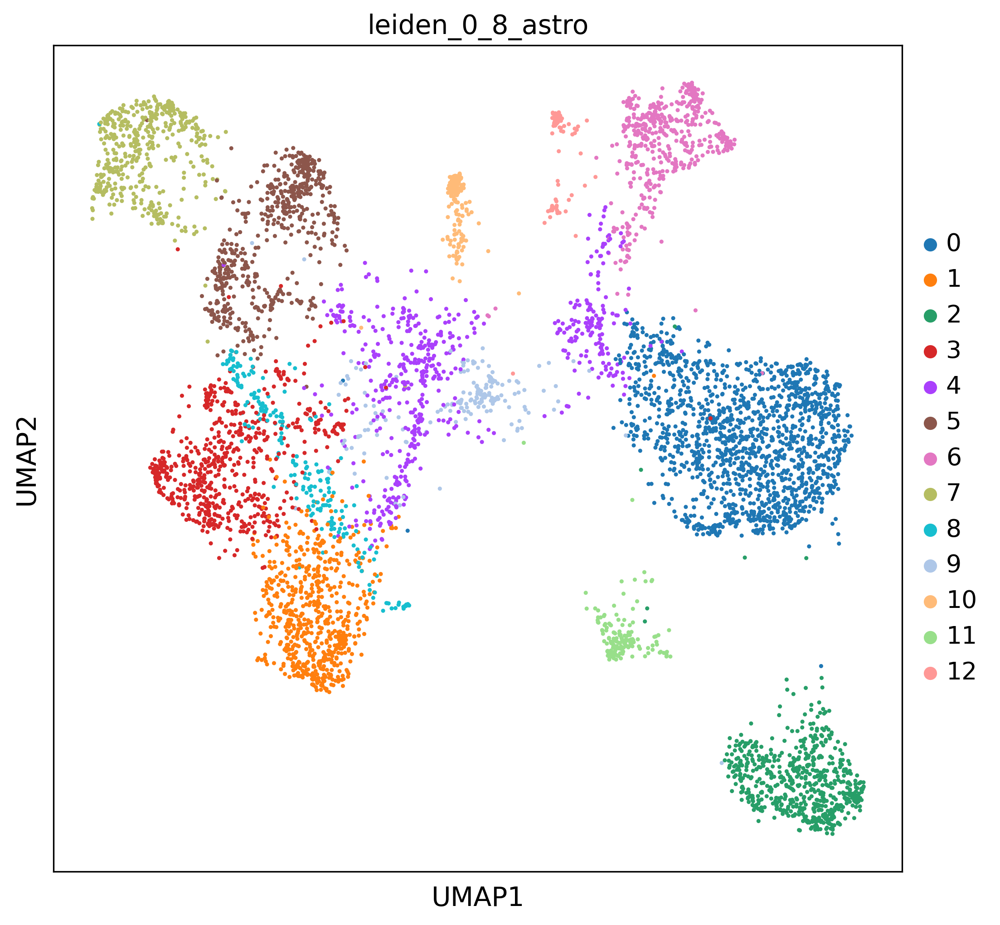

In [454]:
sc.pl.umap(adataastro,color='leiden_0_8_astro',save='INH_leiden_08.pdf')

{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

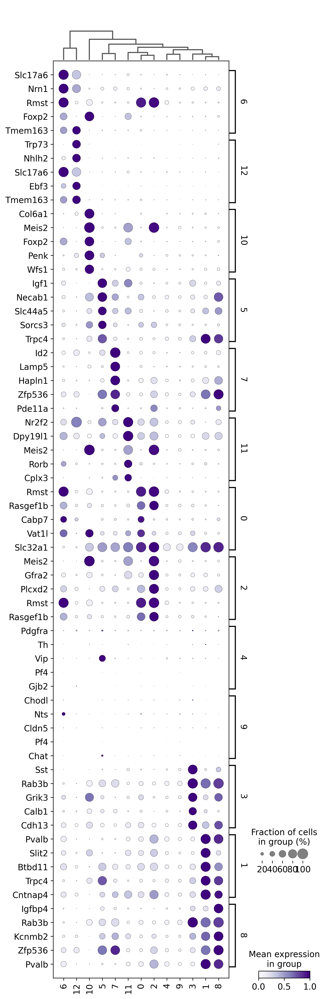

In [455]:
key='leiden_0_8_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=5,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

In [456]:
expastro=pd.DataFrame(adataastro.raw.X,columns=adataastro.var.index)
expastro['celltype']=list(adataastro.obs['leiden_0_8_astro'])
expastro=expastro.groupby('celltype').mean()
exp=exp.loc[:,exp.columns.isin(expastro.columns)]
expastro=expastro.loc[:,expastro.columns.isin(exp.columns)]
exp=exp.fillna(0)
expastro=expastro.fillna(0)
exp=exp.loc[:,expastro.columns]
tbl=pd.DataFrame(index=expastro.index,columns=exp.index)
for ind in expastro.index:
    for col in exp.index:
        tbl.loc[ind,col]=np.corrcoef(expastro.loc[ind,:],exp.loc[col,:])[0,1]
tbl.astype(float).idxmax(axis=1)

celltype
0         20_Ndnf HPF
1         115_Pvalb_2
10          2_Meis2_2
11        20_Ndnf HPF
12             1_CR_1
2           112_Pvalb
3            95_Sst_2
4           112_Pvalb
5           35_Sncg_2
6     135_L2/3 IT PPP
7      3_Lamp5 Lhx6_1
8         115_Pvalb_2
9         115_Pvalb_3
dtype: object

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


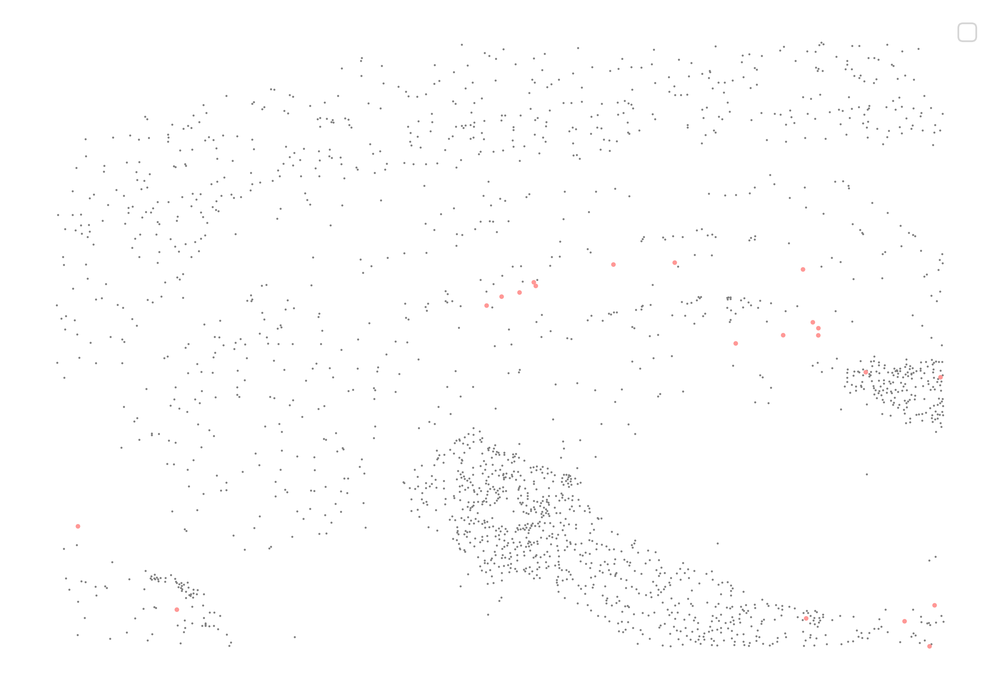

In [459]:
asub=adataastro[adataastro.obs['replicate']=='1']
xp.map_of_clusters(asub,key='leiden_0_8_astro',size=7,clusters=['12'])

In [460]:
annot={'1':'Pvalb INH',
       '0':'INH Thal 2',
       '2':'INH Thal 1',
      '3':'Sst INH',
      '4':'Vip INH',
      '5':'Cck INH',
      '6':'Cajal Retzius',
      '7':'Lamp5 INH',
      '8':'Pvalb INH',
      '9':'Vip INH',
      '10':'Meis2 INH',
      '11':'INH Thal 3',
      '12':'Hippoc INH',}

In [461]:
adataastro.obs['annot']=adataastro.obs['leiden_0_8_astro'].astype(str).map(annot)

In [462]:
adataastro.write(saving_path+'/adata_msbrain_3rep_INH.h5ad')

# Excitatory

In [172]:
adata.obs['Class'].unique()
adataastro=adata[adata.obs['Class']=='Excitatory']
#sc.pp.scale(adataastro)
sc.pp.neighbors(adataastro, n_neighbors=15, n_pcs=40)
sc.tl.leiden(adataastro,resolution=2.2,key_added='leiden_2_2_astro',random_state=1)
sc.tl.leiden(adataastro,resolution=1.8,key_added='leiden_1_8_astro',random_state=1)
sc.tl.leiden(adataastro,resolution=1.4,key_added='leiden_1_4_astro',random_state=1)
sc.tl.leiden(adataastro,resolution=1.0,key_added='leiden_1_0_astro',random_state=1)
sc.tl.leiden(adataastro,resolution=0.4,key_added='leiden_0_4_astro',random_state=1)
sc.tl.leiden(adataastro,resolution=0.1,key_added='leiden_0_1_astro',random_state=1)
sc.tl.leiden(adataastro,resolution=0.8,key_added='leiden_0_8_astro',random_state=1)


In [173]:
sc.tl.umap(adataastro,min_dist=0.2,random_state=1)

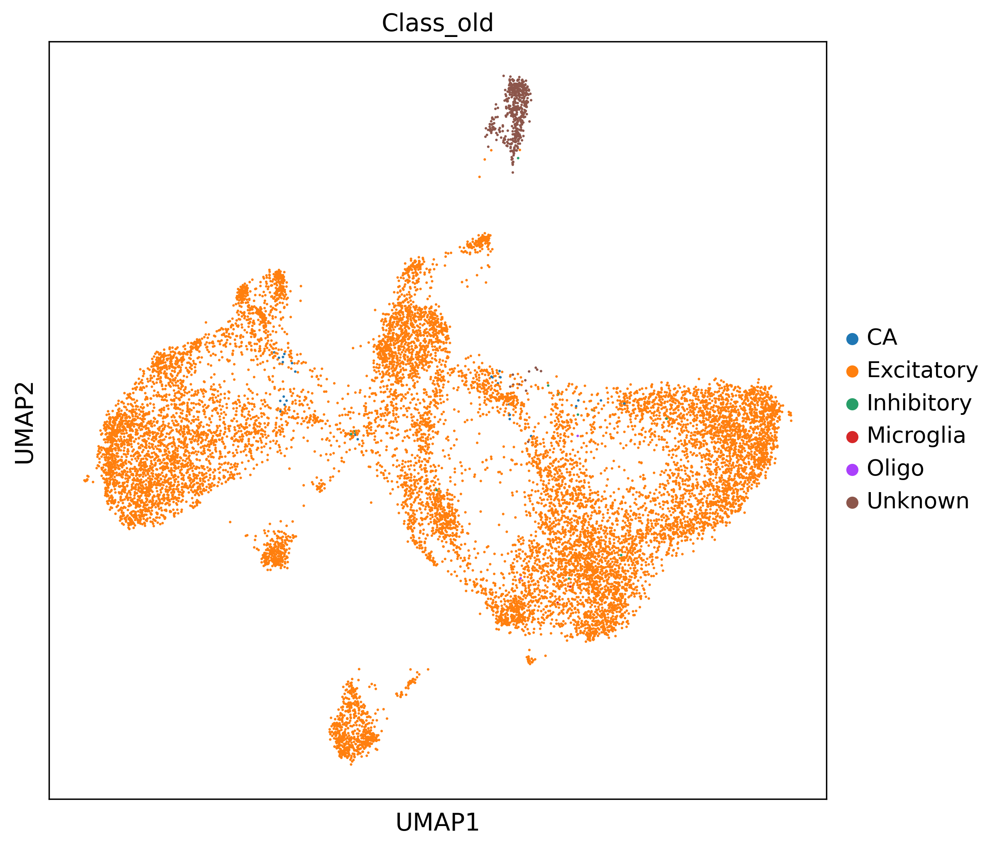

In [175]:
sc.pl.umap(adataastro,color='Class_old')#,save='EXC_leiden_10.pdf')

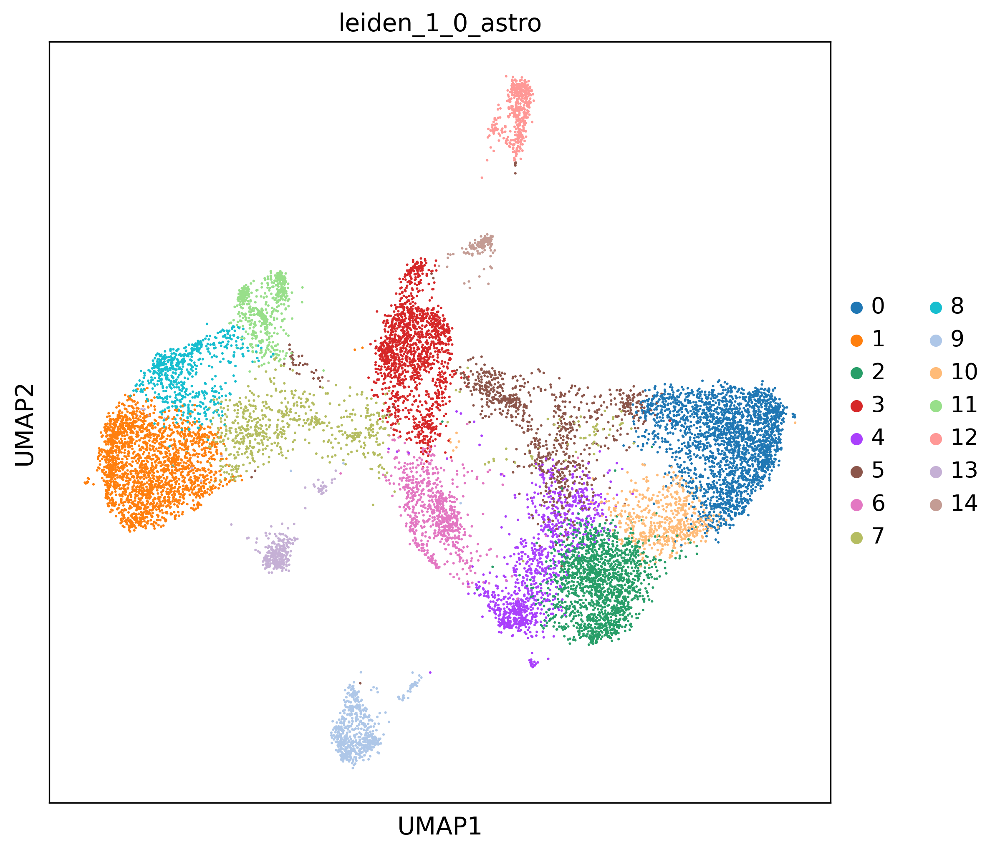

In [176]:
sc.pl.umap(adataastro,color='leiden_1_0_astro',save='EXC_leiden_10.pdf')

{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

<Figure size 1500x1050 with 0 Axes>

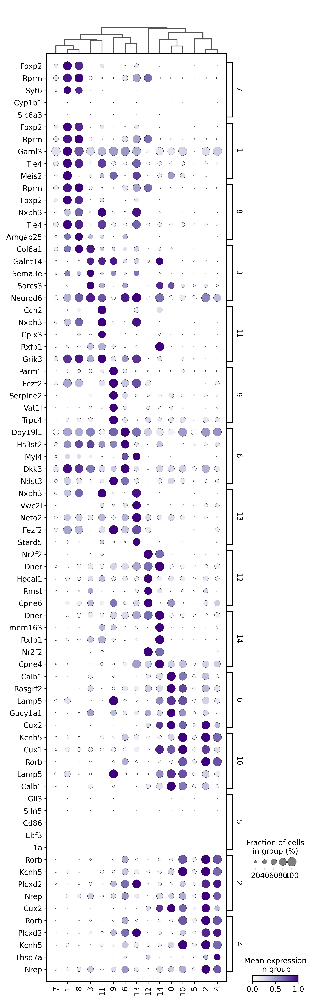

In [177]:
key='leiden_1_0_astro'

sc.pp.log1p(adataastro)
sc.tl.rank_genes_groups(adataastro, groupby=key, method='wilcoxon')
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.figure(figsize=(10,7))
sc.pl.rank_genes_groups_dotplot(adataastro, n_genes=5,standard_scale='var',swap_axes=True,cmap='Purples',show=False)

In [25]:
xp.map_of_clusters?

/mnt/d/Xenium_benchmarking-main/Xenium_benchmarking-main/xb/plotting.py:22: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key]=adata.obs[key].astype(int)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


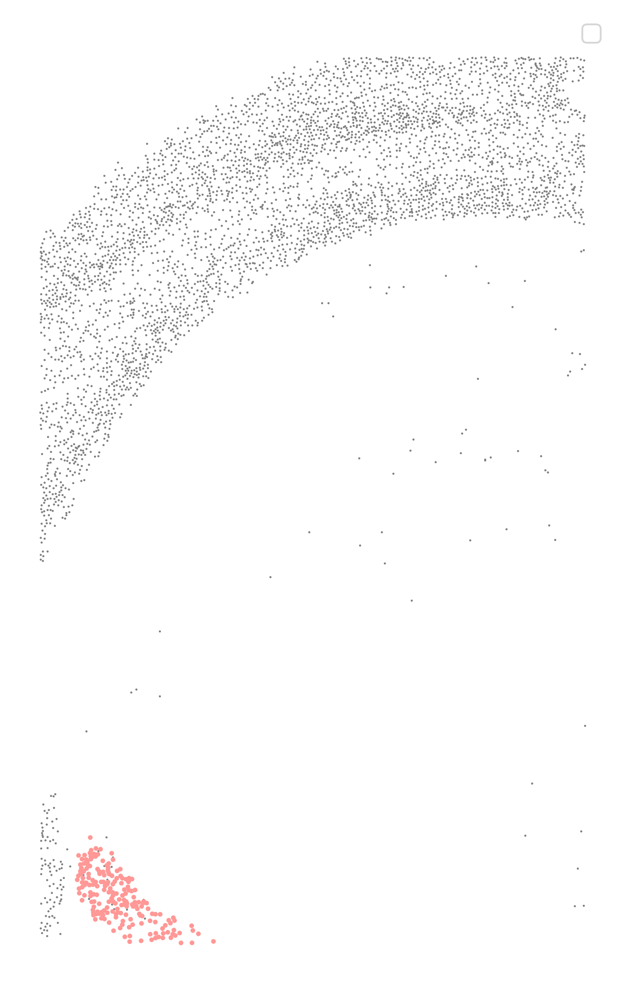

In [178]:
asub=adataastro[adataastro.obs['replicate']=='1']
xp.map_of_clusters(asub,key='leiden_1_0_astro',size=7,figuresize=(6,10),clusters=[12])

In [181]:
exp=pd.read_csv(r"../../data/scRNAseq/mean_expression_Yao_150kcells_104_supertype_label.csv",index_col=0)

In [182]:
expastro=pd.DataFrame(adataastro.raw.X,columns=adataastro.var.index)
expastro['celltype']=list(adataastro.obs['leiden_1_0_astro'])
expastro=expastro.groupby('celltype').mean()
exp=exp.loc[:,exp.columns.isin(expastro.columns)]
expastro=expastro.loc[:,expastro.columns.isin(exp.columns)]
exp=exp.fillna(0)
expastro=expastro.fillna(0)
exp=exp.loc[:,expastro.columns]
tbl=pd.DataFrame(index=expastro.index,columns=exp.index)
for ind in expastro.index:
    for col in exp.index:
        tbl.loc[ind,col]=np.corrcoef(expastro.loc[ind,:],exp.loc[col,:])[0,1]
tbl.astype(float).idxmax(axis=1)

celltype
0        L2/3 IT CTX Stard8
1            L6 CT CTX Syt6
10          L4 IT CTX Rspo1
11            L6b CTX Nxph4
12       L2/3 IT ENTl Ndst4
13         L5/6 NP CTX Sla2
14                     Car3
2     L4/5 IT CTX Cux2 Etv1
3          L5/6 IT CTX Cdh9
4     L4/5 IT CTX Cux2 Etv1
5     L4/5 IT CTX Cux2 Etv1
6           L5 IT CTX Foxo1
7            L6 CT CTX Syt6
8            L6 CT CTX Syt6
9            L5 PT CTX Npnt
dtype: object

In [185]:
tbl.transpose().sort_values(by='11',ascending=False).loc[:,'11'].head(10)

L6b CTX Nxph4                   0.78365
L6b ENT Cplx3 Cobll1           0.771389
L6b CTX Clic5                  0.760296
L6b RHP Nxph4 Cobll1           0.709426
L6 CT CTX Syt6                 0.621767
L6b CTX Slc17a8                0.599579
NP PPP Tmem255b                 0.59543
L5/6 NP CT CTX Sla2 Col12a1    0.576066
L6 CT ENT Rasgrf2 Rmst         0.555345
L5/6 IT TPE-ENT Chn2           0.526132
Name: 11, dtype: object

In [192]:
annot={'0':'L2_3 IT',
       '1':'L6 CT Syt6',
       '2':'L4_5 IT',
      '3':'L5_6_IT',
      '4':'L4_5 IT',
      '5':'L4_5 IT',
      '6':'L5 IT ',
      '7':'L6 CT Syt6',
      '8':'L6 CT Syt6',
      '9':'L5 PT',
      '10':'L4 IT',
      '11':'L6b CTX',
      '12':'Caudoputamen EXC',
      '13':'L5 NP',
      '14':'Car3 EXC',}

In [193]:
adataastro.obs['annot']=adataastro.obs['leiden_1_0_astro'].astype(str).map(annot)

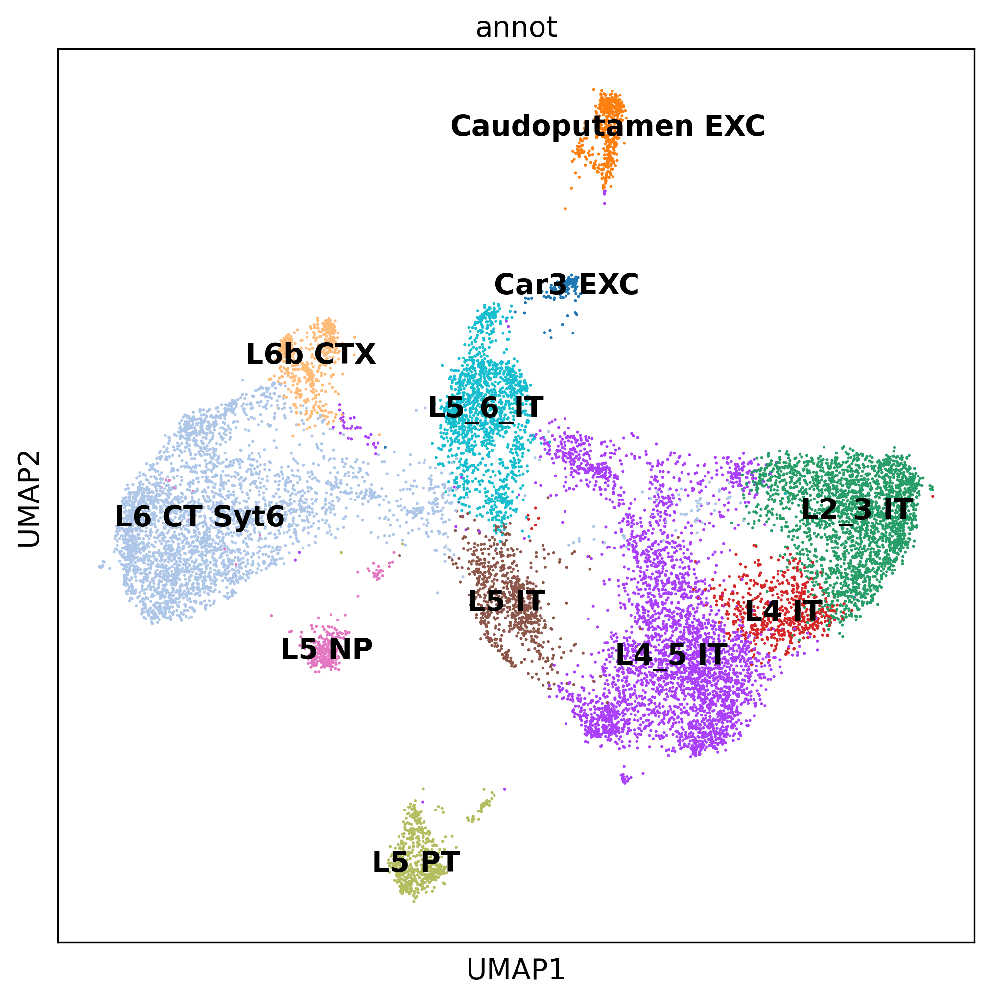

In [194]:
sc.pl.umap(adataastro,color='annot',legend_loc='on data')

In [195]:
adataastro.write(saving_path+'/adata_msbrain_3rep_EXC.h5ad')

# Combining all dictionaries

In [226]:
alldict={}

In [227]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_EXC.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['annot']))
print(np.sum(adatasub.obs['annot'].isna()))
alldict.update(dicti)

0


In [228]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_INH.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['annot']))
print(np.sum(adatasub.obs['annot'].isna()))
alldict.update(dicti)

0


In [229]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_THALEXC.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['annot']))
print(np.sum(adatasub.obs['annot'].isna()))
alldict.update(dicti)

0


In [230]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_CA.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['annot']))
print(np.sum(adatasub.obs['annot'].isna()))
alldict.update(dicti)

0


In [231]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_DG.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['annot']))
print(np.sum(adatasub.obs['annot'].isna()))
alldict.update(dicti)

0


In [232]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_vascular.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['annot']))
print(np.sum(adatasub.obs['annot'].isna()))
alldict.update(dicti)

0


In [233]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_microglia.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['annot']))
print(np.sum(adatasub.obs['annot'].isna()))
alldict.update(dicti)

0


In [234]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_OPC.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['annot']))
print(np.sum(adatasub.obs['annot'].isna()))
alldict.update(dicti)

0


In [235]:
adatasub=sc.read(saving_path+'/adata_msbrain_3rep_astro.h5ad')
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['astro_annot']))
print(np.sum(adatasub.obs['astro_annot'].isna()))
alldict.update(dicti)

0


In [236]:
adata.obs['Class'].unique()
adatasub=adata[adata.obs['Class']=='Oligo']
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['Class']))
alldict.update(dicti)

In [237]:
adata.obs['Class'].unique()
adatasub=adata[adata.obs['Class']=='CP']
dicti=dict(zip(adatasub.obs['cell_code'],adatasub.obs['Class']))
alldict.update(dicti)

In [238]:
len(alldict)

82941

In [239]:
adata

AnnData object with n_obs × n_vars = 82941 × 284
    obs: 'ind', 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'graph_clusters', 'kmeans2_clusters', 'kmeans3_clusters', 'kmeans4_clusters', 'kmeans5_clusters', 'kmeans6_clusters', 'kmeans7_clusters', 'kmeans8_clusters', 'kmeans9_clusters', 'kmeans10_clusters', 'replicate', 'n_counts', 'leiden_2_2', 'leiden_1_8', 'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6', 'cell_code', 'expanded_class', 'expanded_initial_annotation', 'Class', 'initial_annotation', 'celltype_annotation', 'X', 'Y', 'leiden_0_4', 'leiden_0_2', 'Class_old', 'class_number'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Class_colors', 'expanded_class_colors', 'expanded_initial_annotation_colors', 'hvg', 'initial_annotation_colors', 'leiden', 'leiden_0_2_colors', 'leiden_0_4_colors', 'leiden_0_6_colors', 'leiden_2_2_colors', 

In [240]:
adata.obs['initial_annotation']=adata.obs['cell_code'].map(alldict)

In [241]:
adata.obs['celltype_annotation']=adata.obs['cell_code'].map(alldict)

In [242]:
adata.write(saving_path+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation.h5ad')

In [215]:
saving_path+'/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation.h5ad'

'../../data/processed_adata/adata_msbrain_3rep_withclusters_only_nuclei_deep_annotation.h5ad'